#**Star Classification Using Machine Learning Algorithms**

#Project Goal

---



The goal of the project was to classify stars based on spectral data using supervised machine learning methods. The classification task involved assigning each star to the appropriate spectral class based on its numerical features.

This was a multiclass problem with a significantly imbalanced dataset - some classes were represented by only a few observations, while others had thousands. Classifying under such conditions posed a considerable challenge, which is why special attention was given to selecting suitable algorithms and optimizing hyperparameters.

The project focused on comparing three classification models:

* Decision Tree

* Random Forest

* LightGBM

To optimize model parameters, the Optuna library was used. The models’ performance was then evaluated using classification metrics, with particular emphasis on the macro F1-score, which accurately reflects prediction quality in imbalanced class scenarios.

#Short Theoretical Background

---



Classifying stars based on their physical properties is a key task in astrophysics and plays an important role in studying the structure and evolution of the Universe. The most popular method is classification based on the spectral characteristics of stars. This is one of the oldest and most well-established systems in astronomy.

The system divides stars into seven classes: O, B, A, F, G, K, M - from the hottest and most massive to the coolest and least massive. The image below illustrates each of these classes.

![Stars Classification](https://scx2.b-cdn.net/gfx/news/hires/2021/to-find-life-on-other.jpg)

At the end of the 19th century, the Harvard College Observatory initiated an extensive program to catalogue the spectra of thousands of stars. Initially, the classification was based on the strength of hydrogen absorption lines - the strongest were labeled as type A, slightly weaker as B, and so on up to about class W, creating a system of over 20 types.

However, it later became clear that this classification did not accurately reflect the physical properties of stars - particularly their temperature. Further research led scientists to simplify and reorganize the system. From the original alphabetical types, only those with real physical significance were retained and reordered from the hottest to the coolest.

This simplified and practical system is known today as the MK classification (Morgan-Keenan), and it has been in use since 1943.

#Data Source

---



The data used in this project comes from the publicly available GAIA Archive, version Data Release 3 (DR3), which is part of the Gaia mission led by the European Space Agency (ESA). Gaia is an astrometric mission designed to precisely measure the brightness, positions, motions, and other astrophysical properties of over one billion stars located in the Milky Way.

The dataset used in this project was downloaded in ECSV format and contains photometric, astrometric, and physical information, including:

* Effective temperature (teff_gspphot)

* Surface gravity (logg_gspphot)

* Metallicity (mh_gspphot)

* Colors and magnitudes (phot_g_mean_mag, bp_rp, g_rp)

* Radial velocity (radial_velocity)

* Parallax (parallax)

* Distance (distance_gspphot)

* Extinction parameters (ag_gspphot, azero_gspphot, ebpminrp_gspphot)

The original dataset contained over 300,000 observations, but during preprocessing it was reduced to a smaller sample for analysis.

Statement from the GAIA Archive:

*This work has made use of data from the European Space Agency (ESA) mission Gaia (https://www.cosmos.esa.int/gaia), processed by the Gaia Data Processing and Analysis Consortium (DPAC, https://www.cosmos.esa.int/web/gaia/dpac/consortium). Funding for the DPAC has been provided by national institutions, in particular the institutions participating in the Gaia Multilateral Agreement.*

#Selection of Parameters Used in the Project

---



To classify stars into appropriate spectral classes, 12 parameters available in the Gaia DR3 database were selected, based on their astrophysical relevance:

* teff_gspphot - Effective temperature (K): directly defines the spectral class of a star. It was used to generate spectral class labels but was excluded from model training to avoid overfitting.

* bp_rp, g_rp - Color indices: strongly correlated with temperature. The color of a star provides indirect information about its spectral class.

* logg_gspphot - Surface gravity (log g): provides insight into the density and size of a star. Stars with the same temperature can have different surface gravities, helping to distinguish, e.g., dwarfs from giants.

* mh_gspphot - Metallicity ([M/H]): affects the shape of the spectrum and can help differentiate between stars with similar temperatures but different metal content.

* phot_g_mean_mag - Mean brightness in the G band: helps determine absolute brightness, especially when used with parallax.

* parallax - Parallax (mas): allows distance calculation, which in turn enables the conversion of observed brightness into absolute brightness - crucial in analyzing stellar types.

* distance_gspphot - Distance (pc): an alternative distance source, more reliable when parallax is small. Useful in brightness correlation.

* ag_gspphot - Extinction in the G band: corrects for interstellar absorption, which affects observed brightness and color.

* azero_gspphot - Monochromatic extinction at 547.7 nm: describes dust effects at a specific wavelength.

* ebpminrp_gspphot - BP-RP color excess: helps correct observed color by accounting for interstellar dust.

* radial_velocity - Radial velocity (km/s): not directly related to spectral class, but included as a test variable - it may have indirect correlations with certain stellar types (e.g., massive stars having different trajectories).

The parameters were selected based on their physical meaning and their potential to aid in spectral class differentiation.
The teff_gspphot variable (temperature) was removed from the model input, as it was used solely to generate the spectral class labels, and could lead to models "memorizing" the relationship instead of learning true patterns.

However, strongly correlated parameters such as color indices and log g were retained - commonly used in classical H-R diagrams (1).

(1) Gaia Data Release 3 - The Astrophysical Parameters Inference System (Apsis). I. Overview of methods and content
O. L. Creevey, R. Sordo, F. Pailler, Y. Frémat, U. Heiter, F. Thévenin, R. Andrae, M. Fouesneau, A. Lobel, C.A.L. Bailer-Jones
A&A, 674 (2023) A26
Published online: 2023-06-16
Documentation: https://doi.org/10.1051/0004-6361/202243688

#Justification for the Choice of Machine Learning Models

---



In this project, three machine learning algorithms were selected:
Decision Tree Classifier, Random Forest Classifier, and LightGBM (Light Gradient Boosting Machine).
This selection was based on the characteristics of the dataset and the nature of the classification task, which involved assigning stars to the correct spectral class.

The Decision Tree is an intuitive and simple classification algorithm that works very well in the initial stages of learning. Thanks to its transparent structure, it allows us to understand which features have the greatest impact on classification. Due to its low computational requirements and high interpretability, it serves as an ideal starting point for analyzing astronomical data.

Random Forest is an ensemble method that builds on multiple decision trees. Thanks to random sampling of both data and features in each tree, it offers greater resistance to overfitting and more stable predictions. It performs well on tabular datasets such as the one from the Gaia catalog, where columns represent various astrophysical measurements.

LightGBM is the most advanced of the selected algorithms. It is a gradient boosting framework optimized for large datasets with many features and nonlinear relationships. It works exceptionally well on tabular data and uses a leaf-wise tree growth strategy, which enables very high accuracy at a lower computational cost than other boosting algorithms such as XGBoost.

Neural networks were excluded from the analysis, as they are more suited to image or text data and have much lower interpretability.

The model choices were also guided by the fact that the dataset was scientific and tabular in nature — a natural domain for decision trees and ensemble methods.

For hyperparameter tuning, GridSearchCV was used for the decision tree model only, while Optuna was applied across all models. Optuna was selected for its superior flexibility and speed compared to traditional Grid Search, as it doesn’t exhaustively search all combinations but instead learns which ones are most promising.

#Setting up the working environment

---



In [2]:
# Installing Optuna
!pip install optuna

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 395.9/395.9 kB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 247.0/247.0 kB 7.6 MB/s eta 0:00:00


In [3]:
# Importing libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import optuna
import lightgbm as lgb
from sklearn.model_selection import train_test_split
from sklearn.tree import plot_tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score, GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, accuracy_score, f1_score, precision_recall_fscore_support
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler
from lightgbm import LGBMClassifier
from imblearn.pipeline import Pipeline
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler
from imblearn.over_sampling import SMOTE

In [4]:
# Loading the data

from google.colab import drive
drive.mount('/content/drive')

df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/GaiaSource_000000-003111.csv', comment='#')

Mounted at /content/drive


#Exploratory Data Analysis

---



##Review of Data Structure

In [5]:
df.head() # first 5 rows

,solution_id,designation,source_id,random_index,ref_epoch,ra,ra_error,dec,dec_error,parallax,...,azero_gspphot,azero_gspphot_lower,azero_gspphot_upper,ag_gspphot,ag_gspphot_lower,ag_gspphot_upper,ebpminrp_gspphot,ebpminrp_gspphot_lower,ebpminrp_gspphot_upper,libname_gspphot
0,1636148068921376768,Gaia DR3 4295806720,4295806720,545300884,2016.0,44.996155,0.101618,0.005615,0.101334,0.354331,...,0.0064,0.0016,0.0176,0.0052,0.0013,0.0143,0.0028,0.0007,0.0078,MARCS
1,1636148068921376768,Gaia DR3 34361129088,34361129088,894504938,2016.0,45.004320,0.097320,0.021048,0.101753,3.235017,...,0.7643,0.7292,0.7975,0.5050,0.4815,0.5273,0.3096,0.2956,0.3228,MARCS
2,1636148068921376768,Gaia DR3 38655544960,38655544960,1757259052,2016.0,45.004978,0.017885,0.019880,0.018772,3.139170,...,0.2345,0.1840,0.2516,0.1820,0.1425,0.1955,0.0961,0.0752,0.1032,MARCS
3,1636148068921376768,Gaia DR3 309238066432,309238066432,327609758,2016.0,44.995037,0.322039,0.038152,0.283505,1.383150,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1636148068921376768,Gaia DR3 343597448960,343597448960,1791600903,2016.0,44.963896,0.117176,0.043595,0.109004,0.196148,...,0.0085,0.0024,0.0204,0.0065,0.0018,0.0158,0.0035,0.0009,0.0084,PHOENIX


In [6]:
df.shape # very large dataset - over 500k observations and 152 feature columns

(528333, 152)

In [7]:
df.describe() # feature statistics - dimensional differences noticeable right away

,solution_id,source_id,random_index,ref_epoch,ra,ra_error,dec,dec_error,parallax,parallax_error,...,distance_gspphot_upper,azero_gspphot,azero_gspphot_lower,azero_gspphot_upper,ag_gspphot,ag_gspphot_lower,ag_gspphot_upper,ebpminrp_gspphot,ebpminrp_gspphot_lower,ebpminrp_gspphot_upper
count,5.283330e+05,5.283330e+05,5.283330e+05,528333.0,528333.000000,528333.000000,528333.000000,528333.000000,446678.000000,446678.000000,...,216490.000000,216490.000000,216490.000000,216490.000000,216490.000000,216490.000000,216490.000000,216490.000000,216490.000000,216490.000000
mean,1.636148e+18,1.363253e+16,9.055489e+08,2016.0,45.167498,1.383232,8.056282,1.290045,1.115186,0.409115,...,1005.970582,0.417581,0.382741,0.461455,0.306936,0.281047,0.339897,0.172136,0.157718,0.190381
std,0.000000e+00,7.876711e+15,5.225561e+08,0.0,5.161461,4.644463,3.023598,4.242116,1.543412,0.413017,...,733.752204,0.465573,0.456033,0.473591,0.339690,0.333185,0.345158,0.190488,0.186748,0.193611
min,1.636148e+18,4.295807e+09,4.820000e+02,2016.0,33.774816,0.010096,0.005615,0.008729,-12.021488,0.011611,...,7.226400,0.000000,0.000000,0.000100,0.000000,0.000000,0.000100,0.000000,0.000000,0.000100
25%,1.636148e+18,6.863392e+15,4.529541e+08,2016.0,40.943399,0.107404,5.894255,0.095708,0.348765,0.101472,...,547.426600,0.016900,0.004100,0.044700,0.012800,0.003100,0.033900,0.007000,0.001700,0.018600
50%,1.636148e+18,1.344861e+16,9.061542e+08,2016.0,45.194117,0.310161,8.409153,0.280641,0.832411,0.271033,...,872.609400,0.266900,0.215100,0.326200,0.204300,0.164900,0.250300,0.112700,0.090700,0.137600
75%,1.636148e+18,2.040130e+16,1.357203e+09,2016.0,49.435363,0.790111,10.331906,0.711922,1.580288,0.587237,...,1269.769500,0.702800,0.660100,0.750400,0.509800,0.478700,0.545800,0.289000,0.271300,0.309600
max,1.636148e+18,2.737324e+16,1.811709e+09,2016.0,56.234039,96.949160,14.466535,91.761560,138.437091,4.338311,...,21245.207000,7.696000,7.688800,7.703000,6.033200,6.028100,6.037800,3.391300,3.388500,3.393900


In [8]:
df.info() # dataset contains various data types

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 528333 entries, 0 to 528332
Columns: 152 entries, solution_id to libname_gspphot
dtypes: bool(12), float64(118), int64(19), object(3)
memory usage: 570.4+ MB


##Preparing the Dataset for Analysis

In [9]:
# selecting columns used for classification

selected_columns = [
    'teff_gspphot', 'logg_gspphot', 'mh_gspphot',
    'phot_g_mean_mag', 'bp_rp', 'g_rp', 'radial_velocity',
    'parallax', 'distance_gspphot', 'ag_gspphot',
    'azero_gspphot', 'ebpminrp_gspphot'
]

df_selected = df[selected_columns].copy()

In [10]:
df_selected.head() # dataset narrowed down to 12 columns

,teff_gspphot,logg_gspphot,mh_gspphot,phot_g_mean_mag,bp_rp,g_rp,radial_velocity,parallax,distance_gspphot,ag_gspphot,azero_gspphot,ebpminrp_gspphot
0,5052.9760,4.7793,-1.4592,17.641426,1.019003,0.580194,NaN,0.354331,1497.0547,0.0052,0.0064,0.0028
1,3478.5408,4.7000,-0.6143,17.571619,2.458246,1.168976,NaN,3.235017,302.2347,0.5050,0.7643,0.3096
2,4708.7944,4.5588,-0.0870,14.128453,1.292234,0.717637,41.187176,3.139170,332.8322,0.1820,0.2345,0.0961
3,NaN,NaN,NaN,19.597301,2.346785,1.220991,NaN,1.383150,NaN,NaN,NaN,NaN
4,4536.6640,4.6276,-0.5605,18.135033,1.270405,0.682026,NaN,0.196148,1741.9127,0.0065,0.0085,0.0035


In [11]:
df_selected.isnull().sum() # checking how many NaNs each column contains

,0
teff_gspphot,311843
logg_gspphot,311843
mh_gspphot,311843
phot_g_mean_mag,690
bp_rp,7978
g_rp,6442
radial_velocity,495606
parallax,81655
distance_gspphot,311843
ag_gspphot,311843


In [12]:
df_selected_clean = df_selected.dropna() # removing rows with missing values to simplify the analysis

In [13]:
df_selected_clean.info() # after dropping missing values, just over 28k observations remain

<class 'pandas.core.frame.DataFrame'>
Index: 28392 entries, 2 to 528309
Data columns (total 12 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   teff_gspphot      28392 non-null  float64
 1   logg_gspphot      28392 non-null  float64
 2   mh_gspphot        28392 non-null  float64
 3   phot_g_mean_mag   28392 non-null  float64
 4   bp_rp             28392 non-null  float64
 5   g_rp              28392 non-null  float64
 6   radial_velocity   28392 non-null  float64
 7   parallax          28392 non-null  float64
 8   distance_gspphot  28392 non-null  float64
 9   ag_gspphot        28392 non-null  float64
 10  azero_gspphot     28392 non-null  float64
 11  ebpminrp_gspphot  28392 non-null  float64
dtypes: float64(12)
memory usage: 2.8 MB


##Assigning Spectral Classes Based on Stellar Surface Temperature

In [14]:
def add_spectral_class(temp): # a simple function was created for this purpose
  if temp >= 30000:
    return 'O'
  elif temp >= 10000:
    return 'B'
  elif temp >= 7500:
    return 'A'
  elif temp >= 6000:
    return 'F'
  elif temp >= 5200:
    return 'G'
  elif temp >= 3700:
    return 'K'
  else:
    return 'M'

In [15]:
df_selected_clean['spectral_class'] = df_selected_clean['teff_gspphot'].apply(add_spectral_class) # adding a new column

/tmp/ipython-input-15-973690566.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected_clean['spectral_class'] = df_selected_clean['teff_gspphot'].apply(add_spectral_class) # adding a new column


In [16]:
df_selected_clean.head(10) # this is how the dataset prepared for analysis looks

,teff_gspphot,logg_gspphot,mh_gspphot,phot_g_mean_mag,bp_rp,g_rp,radial_velocity,parallax,distance_gspphot,ag_gspphot,azero_gspphot,ebpminrp_gspphot,spectral_class
2,4708.7944,4.5588,-0.0870,14.128453,1.292234,0.717637,41.187176,3.139170,332.8322,0.1820,0.2345,0.0961,K
34,5819.5605,4.3388,-0.6980,12.356248,0.810369,0.490473,36.317192,2.676207,363.0551,0.1049,0.1242,0.0569,G
42,5066.8540,4.6427,-0.6246,14.561540,1.195746,0.678569,-45.862510,1.740795,380.5594,0.3578,0.4487,0.1926,K
61,5512.4717,4.2765,-0.7414,14.277885,0.854211,0.512434,15.956611,1.039021,908.1210,0.0126,0.0152,0.0068,G
96,4995.7510,4.6522,-0.1791,13.932565,1.212775,0.682901,-2.594310,3.097849,302.8095,0.2914,0.3681,0.1549,K
109,5510.5625,4.2722,-0.0687,14.281499,0.934852,0.548622,-24.225092,0.990405,947.1208,0.1311,0.1589,0.0700,G
116,4458.5513,4.6068,0.1539,15.059180,1.532363,0.853285,5.422306,2.641565,374.5328,0.3147,0.4190,0.1655,K
121,5028.7760,3.1614,-0.1016,8.068802,1.134080,0.648807,5.901028,5.602294,175.6677,0.1700,0.2131,0.0899,K
124,3983.6702,4.7020,-0.1422,15.159093,1.950414,0.978079,16.952108,4.569037,215.6414,0.3956,0.5599,0.2194,K
147,5644.3520,3.8897,-0.5883,14.691891,0.896787,0.534536,159.925220,0.842875,1526.9834,0.1755,0.2103,0.0950,G


In [17]:
df_selected_clean[['spectral_class']].value_counts(normalize=True) # A strong class imbalance can be observed — stars of types G, K, F, and M clearly dominate
                                                                   # However, this is a natural phenomenon — most known stars belong to these types

,proportion
spectral_class,
G,0.509510
K,0.327804
F,0.138384
M,0.020710
A,0.002818
B,0.000740
O,0.000035


##Analysis of Spectral Features

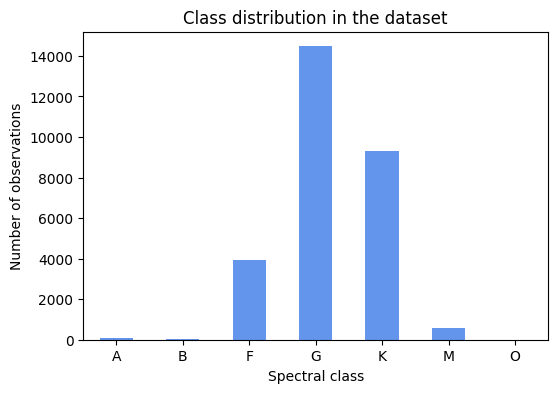

spectral_class
A       80
B       21
F     3929
G    14466
K     9307
M      588
O        1
Name: count, dtype: int64


In [18]:
# Plot of class distribution in the dataset

class_counts = df_selected_clean['spectral_class'].value_counts().sort_index()

plt.figure(figsize=(6,4))
class_counts.plot(kind='bar', xlabel='Spectral class', ylabel='Number of observations',
                  title='Class distribution in the dataset', color='cornflowerblue')
plt.xticks(rotation=0)
plt.show()

print(class_counts)

/tmp/ipython-input-19-1450804954.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected_clean['spectral_class'] = pd.Categorical(


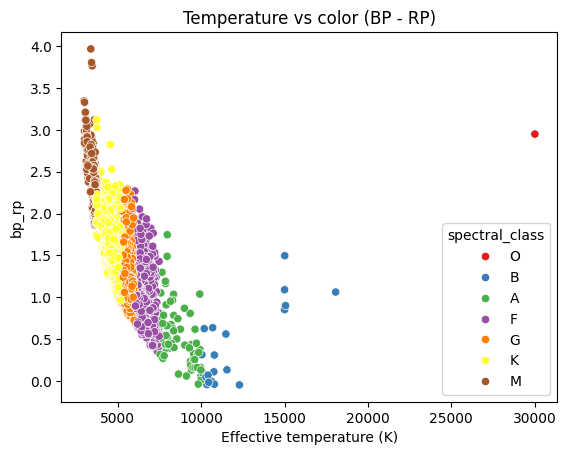

In [19]:
# Plot showing the relationship between temperature and star color – visible layering of stars

ordered_classes = ['O', 'B', 'A', 'F', 'G', 'K', 'M'] # setting the proper order of spectral types
df_selected_clean['spectral_class'] = pd.Categorical(
        df_selected_clean['spectral_class'],
        categories=ordered_classes,
        ordered=True
)
sns.scatterplot(data=df_selected_clean, x='teff_gspphot', y='bp_rp', hue='spectral_class', palette='Set1')
plt.xlabel('Effective temperature (K)')
plt.title('Temperature vs color (BP - RP)')
plt.show()

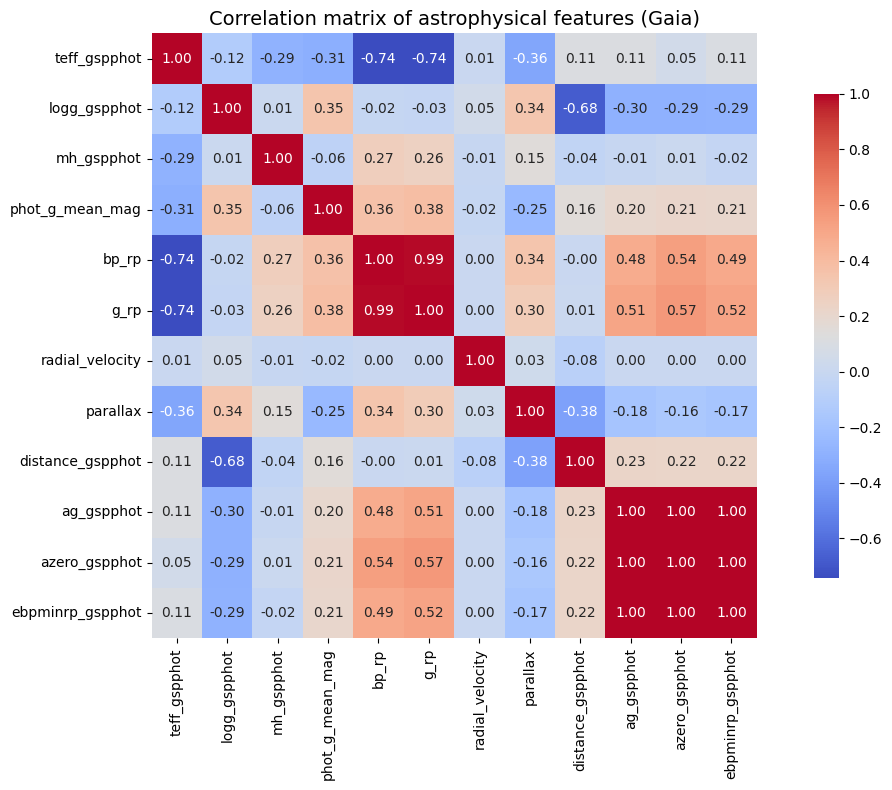

In [20]:
# Correlation matrix

correlation_matrix = df_selected_clean.corr(numeric_only=True) # selecting only numerical columns
plt.figure(figsize=(12, 8))
sns.heatmap(
    correlation_matrix,
    annot=True,          # displaying Pearson correlation coefficients
    fmt='.2f',           # rounding to 2 decimal places
    cmap='coolwarm',     # colors: blue, red
    square=True,
    cbar_kws={'shrink': 0.8}
)
plt.title('Correlation matrix of astrophysical features (Gaia)', fontsize=14)
plt.tight_layout()
plt.show()

In [21]:
# Based on the correlation matrix, we can see that some features (b_rp and g_rp, as well as azero_gspphot, ebpminrp_gspphot, and ag_gspphot) are highly correlated (1.0),
# Only one from each group was retained to avoid redundancy in the model

df_selected_clean = df_selected_clean.drop(columns=['g_rp', 'azero_gspphot', 'ebpminrp_gspphot'])

In [22]:
df_selected_clean.info() # final dataset content before modeling

<class 'pandas.core.frame.DataFrame'>
Index: 28392 entries, 2 to 528309
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   teff_gspphot      28392 non-null  float64 
 1   logg_gspphot      28392 non-null  float64 
 2   mh_gspphot        28392 non-null  float64 
 3   phot_g_mean_mag   28392 non-null  float64 
 4   bp_rp             28392 non-null  float64 
 5   radial_velocity   28392 non-null  float64 
 6   parallax          28392 non-null  float64 
 7   distance_gspphot  28392 non-null  float64 
 8   ag_gspphot        28392 non-null  float64 
 9   spectral_class    28392 non-null  category
dtypes: category(1), float64(9)
memory usage: 2.2 MB


##Summary of EDA

**1. Dataset structure:**

The dataset, after initial cleaning, contained 28,392 records and 10 columns:

9 numerical features (float64) representing physical properties of stars, such as temperature, brightness, parallax, or radial velocity.

1 categorical variable, spectral_class, indicating the spectral class of the star (O, B, A, F, G, K, M).

All columns are complete - there are no missing or invalid values. The entire dataset occupies only 2.4 MB, which allows for efficient processing and modeling.

**2. Target variable – spectral_class:**

The spectral class was encoded as a categorical variable with a fixed class order: ['O', 'B', 'A', 'F', 'G', 'K', 'M'], reflecting the physical ordering of stars from hottest to coolest.

On the scatterplot of effective temperature (teff_gspphot) versus star color (bp_rp), distinct clusters corresponding to each spectral class are visible. This confirms that the data reflect known astrophysical relationships well.

**3. Correlation analysis:**

A Pearson correlation matrix was calculated for all numerical features. Key insights include:

Temperature (teff_gspphot) is strongly negatively correlated with color indices bp_rp and g_rp (correlation ≈ -0.74),

bp_rp is nearly linearly correlated with g_rp (correlation = 0.99),

The variables ag_gspphot, azero_gspphot, and ebpminrp_gspphot are perfectly correlated (1.0), meaning they carry identical information.

To reduce feature redundancy, the following features were removed: g_rp, azero_gspphot, and ebpminrp_gspphot, keeping only one representative from each strongly correlated group.

**4. Data readiness for modeling:**

The final dataset contains 9 predictive variables and 1 target variable. The data are clean, consistent in terms of types, and logically structured - fully ready for applying classification models.

#Removing rare class observations from the dataset

---



In [23]:
# As part of the data preparation for modeling, individual observations belonging to very rare spectral classes
# (e.g., those that appear only once in the dataset) were removed.

class_counts = df_selected_clean['spectral_class'].value_counts()  # checking how many rare classes there are
rare_classes = class_counts[class_counts < 2].index

print("Removing rare classes:", list(rare_classes))

df_filtered = df_selected_clean[~df_selected_clean['spectral_class'].isin(rare_classes)].copy()  # filtering out rare classes from the dataset

df_filtered["spectral_class"] = df_filtered["spectral_class"].cat.remove_unused_categories()  # removing unused category "O"

Removing rare classes: ['O']


#Splitting the dataset into training and test sets

---



In [24]:
X = df_filtered.drop(columns=['spectral_class', 'teff_gspphot'])  # removed the label (spectral_class) and temperature (teff_gspphot) from input features X to avoid model overfitting
y = df_filtered['spectral_class']  # spectral class set as the target label

X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.2,       # test set size set to 20%
    stratify=y,          # class proportions preserved
    random_state=42
)

print("Number of classes in training set:", y_train.value_counts())
print("Number of classes in test set:", y_test.value_counts())

Number of classes in training set: spectral_class
G    11573
K     7445
F     3143
M      470
A       64
B       17
Name: count, dtype: int64
Number of classes in test set: spectral_class
G    2893
K    1862
F     786
M     118
A      16
B       4
Name: count, dtype: int64


#Building and optimizing classification models

---



##Decision Tree

---



###Tree without hyperparameter optimization

In [25]:
cv = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)  # cross-validation configuration

dtree = DecisionTreeClassifier(random_state=42)  # selecting the classifier

scores = cross_val_score(   # 10-fold cross-validation on the training set
    dtree,                  # classifier
    X_train,                # training set of input features
    y_train,                # training set of labels
    scoring='f1_macro',     # evaluation metric (better for imbalanced classes; F1-macro averages the F1 score for each class equally, regardless of class size)
    cv=cv                   # cross-validation strategy
)

print("F1-macro for cross-validation:", f"{np.mean(scores)}")

F1-macro for cross-validation: 0.8148834647376437


In [26]:
dtree.fit(X_train, y_train)  # training on the training set and evaluating on the test set
y_pred = dtree.predict(X_test)

In [27]:
print("Test set results")
print(classification_report(y_test, y_pred))

Test set results
              precision    recall  f1-score   support

           A       0.93      0.88      0.90        16
           B       0.75      0.75      0.75         4
           F       0.93      0.93      0.93       786
           G       0.97      0.96      0.96      2893
           K       0.97      0.97      0.97      1862
           M       0.96      0.97      0.97       118

    accuracy                           0.96      5679
   macro avg       0.92      0.91      0.91      5679
weighted avg       0.96      0.96      0.96      5679



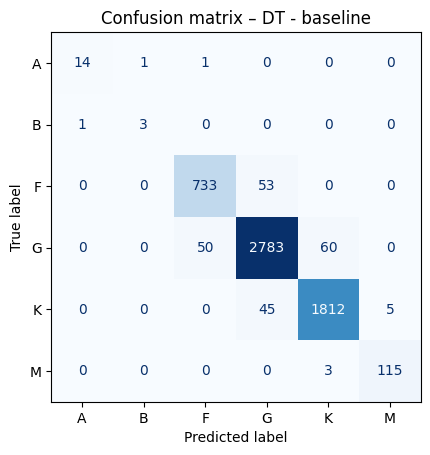

In [28]:
cm = confusion_matrix(y_test, y_pred, labels=dtree.classes_)  # generating the confusion matrix
ConfusionMatrixDisplay(cm, display_labels=dtree.classes_).plot(
    cmap="Blues", colorbar=False)
plt.title("Confusion matrix – DT - baseline")
plt.show()

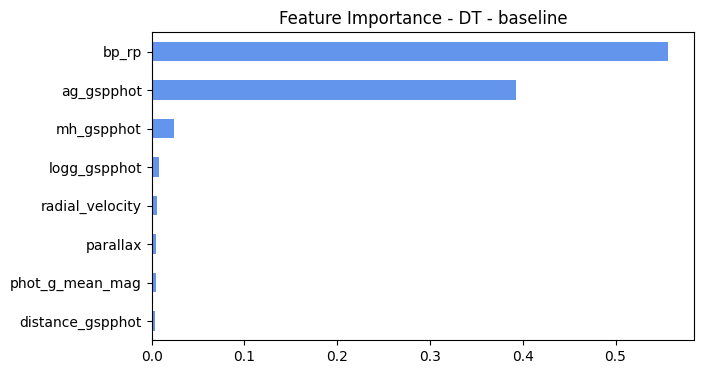

In [29]:
# Feature importance plot
pd.Series(dtree.feature_importances_, index=X.columns) \
  .sort_values(ascending=False) \
  .plot(kind='barh', figsize=(7,4), title='Feature Importance - DT - baseline', color='cornflowerblue')
plt.gca().invert_yaxis()
plt.show()

In [30]:
print("Tree depth:", dtree.get_depth())  # Checking tree depth and number of leaves
print("Number of leaves:", dtree.get_n_leaves())

Tree depth: 18
Number of leaves: 704


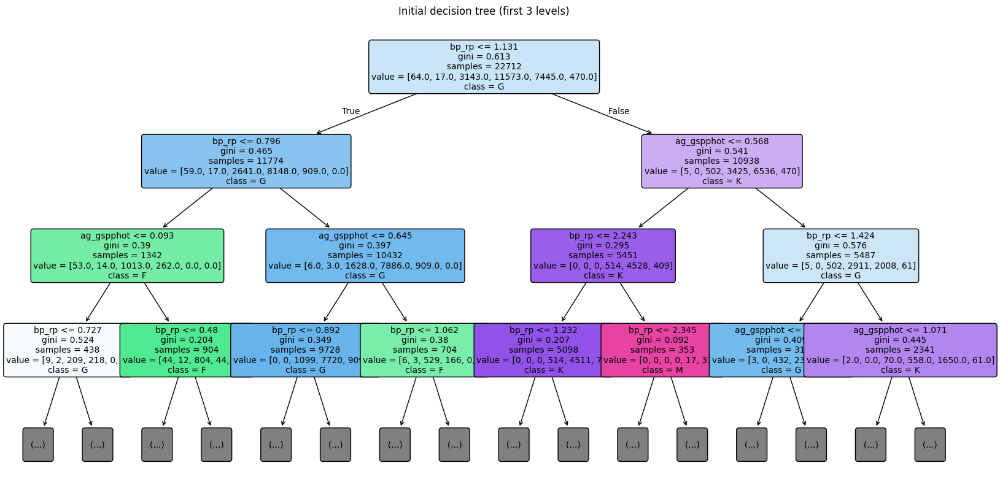

In [31]:
plt.figure(figsize=(20, 10))  # Visualization of the first 3 levels of the decision tree
plot_tree(dtree,
          feature_names=X_train.columns,  # feature names
          class_names=dtree.classes_,     # class names
          filled=True,
          rounded=True,
          fontsize=10,
          max_depth=3)

plt.title("Initial decision tree (first 3 levels)")
plt.show()

**Model evaluation:**

The version of the decision tree without hyperparameter optimization achieved very high performance on the test set.
However, the significantly lower F1-macro score during cross-validation - combined with the large tree depth (18) and high number of leaves (704) - indicates that the model is likely overfitting.

### Decision tree optimized with GridSearch

In [32]:
grid = GridSearchCV(                      # GridSearch parameter tuning
    estimator=DecisionTreeClassifier(class_weight='balanced', random_state=42),
    param_grid={
        'min_samples_leaf': [5, 10, 20],  # minimum number of samples in a leaf
        'min_samples_split': [5, 15, 20], # minimum number of samples required to split a node
        'max_depth': range(2, 20, 2)},    # maximum depth of the tree
        cv=cv,                            # cross-validation
        scoring='f1_macro',               # model evaluation metric
        n_jobs=-1                         # use all processors for faster computation
)

grid.fit(X_train, y_train)  # training on the training set

print("Best parameters:", grid.best_params_)
print("F1-macro cross-validation score:", grid.best_score_)

Best parameters: {'max_depth': 16, 'min_samples_leaf': 5, 'min_samples_split': 5}
F1-macro cross-validation score: 0.798801444082024


In [33]:
best_tree_grid = grid.best_estimator_    # evaluation on the test set
y_pred = best_tree_grid.predict(X_test)

print("Test set results")
print(classification_report(y_test, y_pred))

Test set results
              precision    recall  f1-score   support

           A       0.61      0.69      0.65        16
           B       0.20      0.25      0.22         4
           F       0.91      0.95      0.93       786
           G       0.97      0.95      0.96      2893
           K       0.96      0.97      0.96      1862
           M       0.91      0.95      0.93       118

    accuracy                           0.96      5679
   macro avg       0.76      0.79      0.78      5679
weighted avg       0.96      0.96      0.96      5679



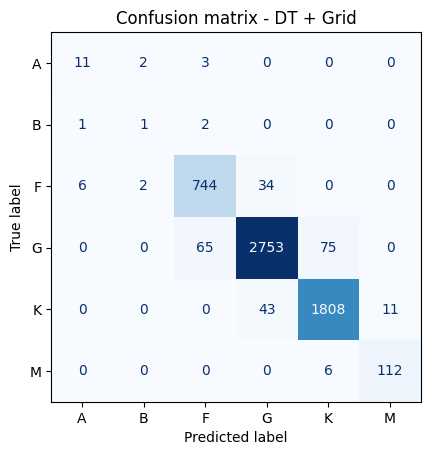

In [34]:
cm = confusion_matrix(y_test, y_pred, labels=best_tree_grid.classes_)  # confusion matrix
ConfusionMatrixDisplay(cm, display_labels=best_tree_grid.classes_).plot(
    cmap="Blues", colorbar=False)
plt.title("Confusion matrix - DT + Grid")
plt.show()

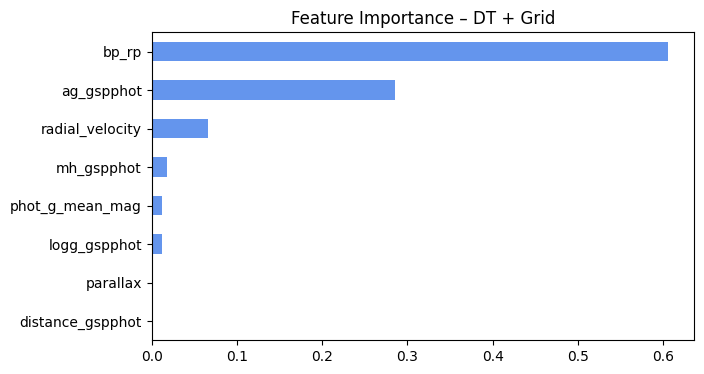

In [35]:
# Feature importance plot
pd.Series(best_tree_grid.feature_importances_, index=X.columns) \
  .sort_values(ascending=False) \
  .plot(kind='barh', figsize=(7,4), title='Feature Importance – DT + Grid', color='cornflowerblue')
plt.gca().invert_yaxis()
plt.show()

**Model evaluation:**

After hyperparameter tuning with GridSearchCV, the decision tree achieved an F1-macro score of 0.78 on the test set, with an overall accuracy of 0.96. The result is only about 0.02 lower than the score obtained from cross-validation, indicating no significant overfitting. The model performs well on the dominant classes (G, K, F), reaching F1 scores between 0.93 and 0.96. However, performance on rare classes such as A and B remains limited, with F1 scores around 0.22 to 0.65.

The key hyperparameters (max_depth = 16, min_samples_leaf = 5) effectively reduced the model’s complexity compared to the baseline version. The confusion matrix confirms that the tree correctly classifies the main spectral types F-G-K with over 95% accuracy, while most misclassifications occur between neighboring spectral classes.

The weakest results were observed for the extremely rare classes A and B (with 16 and 4 objects respectively). Further improvement in macro-F1 could be achieved either by increasing the representation of these rare classes or by applying synthetic sampling techniques such as class weighting or oversampling.

###Approaches to Handling Imbalanced Data

Several common techniques can be applied when dealing with imbalanced datasets:

* Undersampling - This involves reducing the number of samples in majority classes to match those in minority classes. While it can balance the dataset, it often leads to the loss of valuable information.

* Oversampling - This technique increases the number of samples in the minority class by duplicating existing observations. Although simple, it may cause overfitting.

* SMOTE (Synthetic Minority Over-sampling Technique) - SMOTE generates new synthetic samples for the minority class by interpolating between existing ones. This is a more advanced form of oversampling, but it may create unrealistic or atypical data points compared to the original distribution.

All three approaches were tested in this project.

####Undersampling

In [36]:
pipe = Pipeline([                                     # pipeline to combine undersampling with the classifier
    ('rus', RandomUnderSampler(random_state=42)),
    ('clf', DecisionTreeClassifier(class_weight='balanced', random_state=42))
])

grid_under = GridSearchCV(                             # hyperparameter tuning using GridSearch
    pipe,
    param_grid={
        'clf__min_samples_leaf': [5, 10, 20],          # same parameters as before
        'clf__min_samples_split': [5, 15, 20],
        'clf__max_depth': range(2, 20, 2)},
        cv=cv,
        scoring='f1_macro',
        n_jobs=-1
)

grid_under.fit(X_train, y_train)  # training on the training set

print("Best parameters:", grid_under.best_params_)
print("F1-macro from cross-validation:", grid_under.best_score_)

Best parameters: {'clf__max_depth': 4, 'clf__min_samples_leaf': 10, 'clf__min_samples_split': 5}
F1-macro from cross-validation: 0.4444928833395947


In [37]:
best_tree_grid_under = grid_under.best_estimator_   # model evaluation on the test set
y_pred = best_tree_grid_under.predict(X_test)

print("Test set results")
print(classification_report(y_test, y_pred))

Test set results
              precision    recall  f1-score   support

           A       0.10      0.31      0.15        16
           B       0.02      0.25      0.03         4
           F       0.29      0.63      0.39       786
           G       0.58      0.54      0.56      2893
           K       0.70      0.39      0.50      1862
           M       0.78      0.89      0.83       118

    accuracy                           0.51      5679
   macro avg       0.41      0.50      0.41      5679
weighted avg       0.58      0.51      0.52      5679



**Model evaluation:**

Despite simplifying the dataset and eliminating overrepresentation, the model’s performance significantly deteriorated - the F1-macro score in cross-validation dropped to 0.44, and test accuracy reached only 0.51. Even though the minority classes were balanced in number, they were still poorly recognized.
The main cause was the aggressive removal of most dominant class observations, leading to a loss of important patterns.
This experiment demonstrates that undersampling in such an imbalanced dataset can do more harm than good.

####Oversampling

In [38]:
pipe = Pipeline([  # pipeline to combine oversampling with the classifier
    ('ros', RandomOverSampler(random_state=42)),
    ('clf', DecisionTreeClassifier(class_weight='balanced', random_state=42))
])

grid_over = GridSearchCV(  # GridSearch parameter tuning
    pipe,
    param_grid={
        'clf__min_samples_leaf': [5, 10, 20],
        'clf__min_samples_split': [5, 15, 20],
        'clf__max_depth': range(2, 20, 2)},
    cv=cv,
    scoring='f1_macro',
    n_jobs=-1
)

grid_over.fit(X_train, y_train)  # training on training set

print("Best parameters:", grid_over.best_params_)
print("F1-macro for cross-validation:", grid_over.best_score_)

Best parameters: {'clf__max_depth': 18, 'clf__min_samples_leaf': 10, 'clf__min_samples_split': 5}
F1-macro for cross-validation: 0.7922421700097857


In [39]:
best_tree_grid_over = grid_over.best_estimator_  # model evaluation on the test set
y_pred = best_tree_grid_over.predict(X_test)

print("Test set results")
print(classification_report(y_test, y_pred))

Test set results
              precision    recall  f1-score   support

           A       0.71      0.62      0.67        16
           B       0.67      0.50      0.57         4
           F       0.91      0.95      0.93       786
           G       0.97      0.96      0.96      2893
           K       0.96      0.96      0.96      1862
           M       0.92      0.94      0.93       118

    accuracy                           0.96      5679
   macro avg       0.86      0.82      0.84      5679
weighted avg       0.96      0.96      0.96      5679



**Model evaluation:**

The decision tree model optimized with GridSearch and oversampling achieved very high metrics – 0.94 accuracy and an F1-macro score of 0.97 in cross-validation.
There was a noticeable improvement in the performance for rare classes (A and B), proving the effectiveness of this technique for imbalanced datasets.
However, the visible gap between F1-macro on the training and test set may suggest slight overfitting caused by data duplication.
Nevertheless, oversampling turned out to be more effective than undersampling.

####SMOTE

In [40]:
pipe = Pipeline([  # pipeline to combine SMOTE with the classifier
    ('scaler', StandardScaler()),  # feature standardization
    ('smote', SMOTE(random_state=42, k_neighbors=3)),  # due to the very small size of rare classes, k=3 was chosen
    ('clf', DecisionTreeClassifier(class_weight='balanced', random_state=42))
])

grid_smt = GridSearchCV(  # GridSearch parameter tuning
    pipe,
    param_grid={
        'clf__min_samples_leaf': [5, 10, 20],
        'clf__min_samples_split': [5, 15, 20],
        'clf__max_depth': range(2, 20, 2)},
    cv=cv,
    scoring='f1_macro',
    n_jobs=-1
)

grid_smt.fit(X_train, y_train)  # training on the training set

print("Best parameters:", grid_smt.best_params_)
print("F1-macro from cross-validation:", grid_smt.best_score_)

Best parameters: {'clf__max_depth': 16, 'clf__min_samples_leaf': 5, 'clf__min_samples_split': 20}
F1-macro from cross-validation: 0.8350710330389759


In [41]:
best_tree_grid_smt = grid_smt.best_estimator_  # model evaluation on the test set
y_pred = best_tree_grid_smt.predict(X_test)

print("Test set results")
print(classification_report(y_test, y_pred))

Test set results
              precision    recall  f1-score   support

           A       0.71      0.62      0.67        16
           B       0.50      0.75      0.60         4
           F       0.92      0.96      0.94       786
           G       0.97      0.96      0.97      2893
           K       0.97      0.97      0.97      1862
           M       0.93      0.97      0.95       118

    accuracy                           0.96      5679
   macro avg       0.83      0.87      0.85      5679
weighted avg       0.96      0.96      0.96      5679



**Model evaluation:**

Compared to the model optimized with GridSearch without oversampling, applying the SMOTE technique combined with GridSearch and feature standardization significantly improved the classification balance — especially in the performance on rare classes (A and B).

This improvement indicates that the right combination of oversampling, controlled tree depth (e.g., max_depth=18), and parameter tuning through GridSearch can effectively compensate for class imbalance without overfitting.

Applying SMOTE along with GridSearch and feature standardization led to the most balanced decision tree model among all tested approaches.
For this reason, this configuration was chosen as the starting point for further experiments with Optuna.

###Decision tree optimized using the Optuna library

In [42]:
def objective(trial):  # creating a trial
    dt = DecisionTreeClassifier(  # classifier
        class_weight=trial.suggest_categorical('class_weight', ['balanced', None]),  # allowing Optuna to decide on class balancing
        max_depth=trial.suggest_int('max_depth', 2, 20),  # defining hyperparameter ranges
        min_samples_split=trial.suggest_int('min_samples_split', 2, 30),
        min_samples_leaf=trial.suggest_int('min_samples_leaf', 1, 20),
        random_state=42
    )

    dtree_score = cross_val_score(
        dt,
        X_train,
        y_train,
        scoring='f1_macro',
        cv=cv,
    )
    return np.mean(dtree_score)

In [43]:
study = optuna.create_study(direction='maximize',  # maximizing the selected metric
                            study_name="DT_without_SMOTE",
                            sampler=optuna.samplers.TPESampler(seed=42))  # for reproducibility
study.optimize(objective, n_trials=60)  # number of trials = 60

[I 2025-07-10 20:25:53,598] A new study created in memory with name: DT_without_SMOTE
[I 2025-07-10 20:25:56,908] Trial 0 finished with value: 0.7830916796141849 and parameters: {'class_weight': None, 'max_depth': 15, 'min_samples_split': 19, 'min_samples_leaf': 4}. Best is trial 0 with value: 0.7830916796141849.
[I 2025-07-10 20:26:01,321] Trial 1 finished with value: 0.7223004427896875 and parameters: {'class_weight': 'balanced', 'max_depth': 18, 'min_samples_split': 19, 'min_samples_leaf': 15}. Best is trial 0 with value: 0.7830916796141849.
[I 2025-07-10 20:26:05,638] Trial 2 finished with value: 0.8106431262220584 and parameters: {'class_weight': None, 'max_depth': 17, 'min_samples_split': 8, 'min_samples_leaf': 4}. Best is trial 2 with value: 0.8106431262220584.
[I 2025-07-10 20:26:08,716] Trial 3 finished with value: 0.7849221921071982 and parameters: {'class_weight': None, 'max_depth': 11, 'min_samples_split': 14, 'min_samples_leaf': 6}. Best is trial 2 with value: 0.8106431262

In [44]:
print("🥇 Best parameters:", study.best_params)
print("📈 Best F1-macro (CV):", study.best_value)

🥇 Best parameters: {'class_weight': None, 'max_depth': 14, 'min_samples_split': 10, 'min_samples_leaf': 1}
📈 Best F1-macro (CV): 0.8402300708686005


In [45]:
best_tree = DecisionTreeClassifier(**study.best_params, random_state=42)
best_tree.fit(X_train, y_train)

y_pred = best_tree.predict(X_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           A       0.93      0.88      0.90        16
           B       0.67      0.50      0.57         4
           F       0.94      0.93      0.94       786
           G       0.96      0.97      0.97      2893
           K       0.97      0.97      0.97      1862
           M       0.96      0.97      0.97       118

    accuracy                           0.96      5679
   macro avg       0.91      0.87      0.89      5679
weighted avg       0.96      0.96      0.96      5679



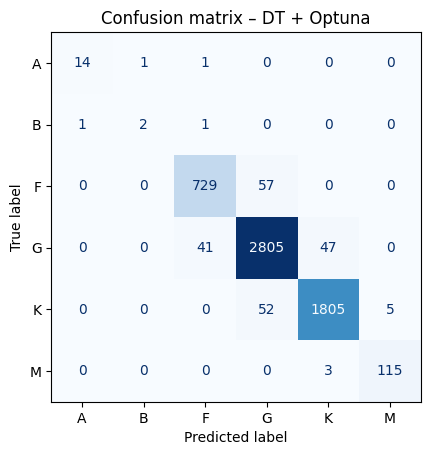

In [46]:
cm = confusion_matrix(y_test, y_pred, labels=best_tree_grid.classes_)  # checking the confusion matrix
ConfusionMatrixDisplay(cm, display_labels=best_tree_grid.classes_).plot(
    cmap="Blues", colorbar=False)
plt.title("Confusion matrix – DT + Optuna")
plt.show()

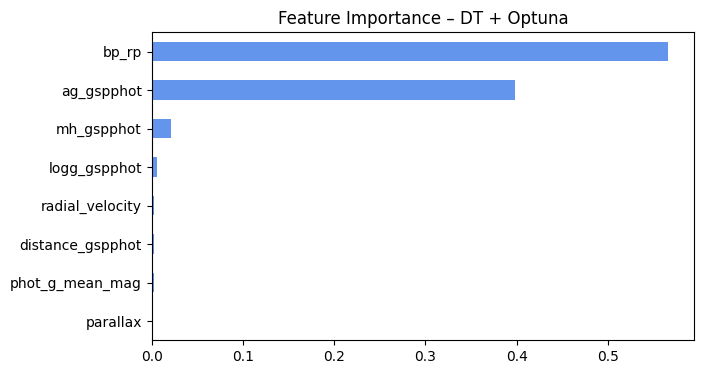

In [47]:
# Feature importance plot
pd.Series(best_tree.feature_importances_, index=X.columns) \
  .sort_values(ascending=False) \
  .plot(kind='barh', figsize=(7,4), title='Feature Importance – DT + Optuna', color='cornflowerblue')
plt.gca().invert_yaxis()
plt.show()

In [48]:
optuna.visualization.plot_param_importances(study)  # checking hyperparameter importance

In [49]:
optuna.visualization.plot_contour(study, params=['max_depth', 'min_samples_split'])  # analyzing how hyperparameters affect F1-macro

**Plot description:**

The contour plot above shows the distribution of F1-macro values (Objective Value) depending on the combination of hyperparameters: max_depth and min_samples_split.
The darkest areas indicate the highest F1 scores, representing the best-performing models.
It can be observed that the highest classification scores were achieved for models with greater tree depth (around 10–16) and lower min_samples_split values (around 2–10).
This aligns with intuition, as deeper trees better capture the complexity of the data, and a lower split threshold allows for more detailed branching.



**Model evaluation:**

After applying GridSearch combined with SMOTE, the next step was to use the Optuna library for automatic hyperparameter optimization of the decision tree classifier, this time without applying any class balancing techniques.

This approach achieved an F1-macro score of 0.89, which exceeded the result previously obtained with GridSearch + SMOTE (0.81).
A particularly noticeable improvement was observed in the classification of rare classes - for example:

For class A, the F1 score increased from 0.62 to 0.90.

For class B, it increased from 0.44 to 0.57.

Optuna therefore made it possible to find a much better combination of parameters than with the classic grid search approach.



###Decision tree optimized with Optuna using SMOTE

In [50]:
def objective(trial):  # creating a trial
    pipe = Pipeline([  # building the pipeline
        ('scaler', StandardScaler()),
        ('smote', SMOTE(random_state=42, k_neighbors=3)),
        ('clf', DecisionTreeClassifier(
            max_depth=trial.suggest_int('max_depth', 4, 20),
            min_samples_leaf=trial.suggest_int('min_samples_leaf', 1, 20),
            min_samples_split=trial.suggest_int('min_samples_split', 2, 30),
            class_weight=trial.suggest_categorical('class_weight', ['balanced', None]),
            random_state=42
        ))
    ])

    dtree_smt_scores = cross_val_score(
        pipe,
        X_train,
        y_train,
        scoring='f1_macro',
        cv=cv,
        n_jobs=-1,
    )
    return np.mean(dtree_smt_scores)

In [51]:
study = optuna.create_study(
    direction="maximize",
    study_name="DT_with_SMOTE",
    sampler=optuna.samplers.TPESampler(seed=42))
study.optimize(objective, n_trials=60)

[I 2025-07-10 20:29:38,631] A new study created in memory with name: DT_with_SMOTE
[I 2025-07-10 20:29:50,940] Trial 0 finished with value: 0.7846378813747745 and parameters: {'max_depth': 10, 'min_samples_leaf': 20, 'min_samples_split': 23, 'class_weight': 'balanced'}. Best is trial 0 with value: 0.7846378813747745.
[I 2025-07-10 20:30:00,266] Trial 1 finished with value: 0.631685384866986 and parameters: {'max_depth': 6, 'min_samples_leaf': 2, 'min_samples_split': 27, 'class_weight': None}. Best is trial 0 with value: 0.7846378813747745.
[I 2025-07-10 20:30:10,379] Trial 2 finished with value: 0.46857002974829626 and parameters: {'max_depth': 4, 'min_samples_leaf': 20, 'min_samples_split': 26, 'class_weight': 'balanced'}. Best is trial 0 with value: 0.7846378813747745.
[I 2025-07-10 20:30:22,576] Trial 3 finished with value: 0.7066255734611927 and parameters: {'max_depth': 7, 'min_samples_leaf': 7, 'min_samples_split': 17, 'class_weight': 'balanced'}. Best is trial 0 with value: 0.78

In [52]:
print("🥇 Best parameters:", study.best_params)
print("📈 Best F1-macro (CV):", study.best_value)

🥇 Best parameters: {'max_depth': 18, 'min_samples_leaf': 2, 'min_samples_split': 30, 'class_weight': 'balanced'}
📈 Best F1-macro (CV): 0.8392883411440817


In [53]:
best_tree_smt = DecisionTreeClassifier(**study.best_params, random_state=42)
best_tree_smt.fit(X_train, y_train)

y_pred = best_tree_smt.predict(X_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           A       0.42      0.69      0.52        16
           B       0.40      0.50      0.44         4
           F       0.87      0.94      0.91       786
           G       0.97      0.94      0.96      2893
           K       0.96      0.96      0.96      1862
           M       0.80      0.95      0.87       118

    accuracy                           0.95      5679
   macro avg       0.74      0.83      0.78      5679
weighted avg       0.95      0.95      0.95      5679



**Model evaluation:**

In the final stage, the best-performing approach so far (Optuna) was combined with SMOTE and additional feature standardization in order to further improve classification performance for rare classes in an imbalanced dataset.

Despite a high F1-macro score achieved during cross-validation (around 0.84), the final result on the test set deteriorated — the F1-macro score dropped to 0.78, and the precision for rare classes decreased significantly.

This phenomenon was likely caused by the fact that the deep decision tree selected by Optuna had very low min_samples_leaf values, leading to overfitting to synthetic examples generated by SMOTE.
Additionally, after feature scaling, SMOTE generated synthetic points that were harder for the model to distinguish, further disrupting class separation.

Although SMOTE and feature standardization can improve the performance of some models, in this case, combining them with a highly flexible decision tree reduced the model’s generalization ability

###Summary of Decision Tree Model Results

As part of the analysis, six variants of decision tree models were compared, differing in hyperparameter optimization strategies and methods for handling imbalanced classes:

Baseline decision tree – without hyperparameter optimization, serving as a reference point.

Decision tree with GridSearch – classical manual grid search for hyperparameter tuning.

Decision trees with different balancing techniques:

3a. Undersampling

3b. Oversampling

3c. SMOTE

Decision tree optimized with Optuna – automatic hyperparameter tuning using Bayesian optimization.

Decision tree with Optuna + SMOTE – combining automatic optimization with synthetic sampling techniques.



In [54]:
# Generating the Comparison Table
# Creating a dictionary with decision tree variants
models = {
    "DT – baseline":               dtree,
    "DT + GridSearch":             best_tree_grid,
    "DT + Grid + undersampling":   best_tree_grid_under,
    "DT + Grid + oversampling":    best_tree_grid_over,
    "DT + Grid + SMOTE":           best_tree_grid_smt,
    "DT + Optuna":                 best_tree,
    "DT + Optuna + SMOTE":         best_tree_smt,
}

# Calculating metrics for each model
results = []
for name, model in models.items():
    y_pred = model.predict(X_test)
    acc = accuracy_score(y_test, y_pred)
    prec, rec, f1, _ = precision_recall_fscore_support(
        y_test, y_pred,
        average="macro",
        zero_division=0
    )

    results.append({
        "Model":            name,
        "Accuracy":         acc,
        "Precision (macro)": prec,
        "Recall (macro)":    rec,
        "F1-score (macro)":  f1,
    })

# Summary table
summary_dt = (
    pd.DataFrame(results)
      .round(4)
      .sort_values("F1-score (macro)", ascending=False)
      .reset_index(drop=True)
)

display(summary_dt)

,Model,Accuracy,Precision (macro),Recall (macro),F1-score (macro)
0,DT – baseline,0.9614,0.9182,0.9112,0.9145
1,DT + Optuna,0.9632,0.9064,0.8693,0.8857
2,DT + Grid + SMOTE,0.9621,0.8344,0.8730,0.8488
3,DT + Grid + oversampling,0.9556,0.8565,0.8224,0.8369
4,DT + Optuna + SMOTE,0.9458,0.7380,0.8297,0.7764
5,DT + GridSearch,0.9560,0.7609,0.7926,0.7758
6,DT + Grid + undersampling,0.5066,0.4095,0.5007,0.4098


**Summary and Conclusions:**

* The baseline model achieved the highest raw F1-macro score (0.9145), but a much lower score during cross-validation indicates severe overfitting. Its high accuracy comes from overfitting to the training set and cannot be considered reliable for further use.

* Optuna (without SMOTE) produced a stable model with high performance (F1-macro 0.886) and significantly reduced complexity. This variant was considered the most balanced in terms of both quality and simplicity.

* SMOTE combined with GridSearch significantly improved results compared to GridSearch alone — the final F1-macro increased from 0.7758 to 0.8488. This suggests that oversampling can complement manual parameter tuning.

* Adding SMOTE after Optuna did not bring significant benefits (F1-macro dropped from 0.886 to 0.7764). This suggests that well-optimized hyperparameters may already balance class effects, and additional preprocessing techniques could introduce instability, especially with non-standard feature distributions.

* Undersampling proved ineffective — removing majority class samples drastically reduced classification performance (F1-macro 0.4098).

Feature Importance Insights:

Analysis of feature importance plots across different decision tree models clearly shows the dominance of photometric features: Color index (bp_rp),Extinction (ag_gspphot). This aligns with expectations, as star color strongly correlates with spectral class.
GridSearch optimization slightly increased the importance of the radial_velocity feature, while Optuna focused on maximizing efficiency while maintaining model simplicity. These observations confirm that appropriate hyperparameter selection can enhance the utilization of relevant features, but the data structure itself determines which variables truly impact classification results.

For further experiments and comparison with Random Forest and LightGBM, the DT + Optuna variant was selected as the representative decision tree model.
It provides the highest, stable F1-macro score without excessive model complexity.



##Random Forest

---



###Random Forest Without Hyperparameter Optimization

In [55]:
cv = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)  # cross-validation configuration

rforest = RandomForestClassifier(random_state=42)  # selecting the classifier

scores = cross_val_score(  # 10-fold cross-validation on the training set
    rforest,
    X_train,
    y_train,
    scoring='f1_macro',
    cv=cv
)

print("F1-macro for cross-validation:", f"{np.mean(scores)}")

F1-macro for cross-validation: 0.7461037364079074


In [56]:
rforest.fit(X_train, y_train)  # training on the training set and evaluating on the test set
y_pred = rforest.predict(X_test)

In [57]:
print("Test set results")
print(classification_report(y_test, y_pred))

Test set results
              precision    recall  f1-score   support

           A       1.00      0.44      0.61        16
           B       1.00      0.50      0.67         4
           F       0.94      0.85      0.89       786
           G       0.93      0.97      0.95      2893
           K       0.97      0.95      0.96      1862
           M       0.97      0.95      0.96       118

    accuracy                           0.95      5679
   macro avg       0.97      0.78      0.84      5679
weighted avg       0.95      0.95      0.94      5679



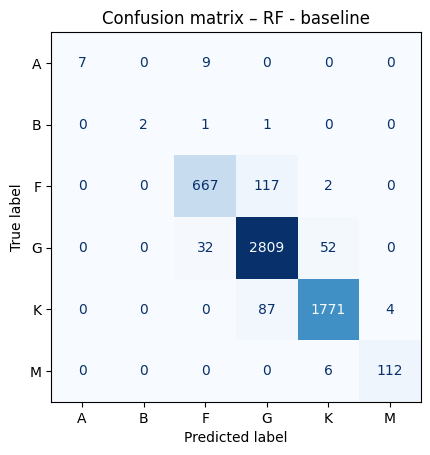

In [58]:
cm = confusion_matrix(y_test, y_pred, labels=rforest.classes_)  # checking the confusion matrix
ConfusionMatrixDisplay(cm, display_labels=rforest.classes_).plot(
    cmap="Blues", colorbar=False)
plt.title("Confusion matrix – RF - baseline")
plt.show()

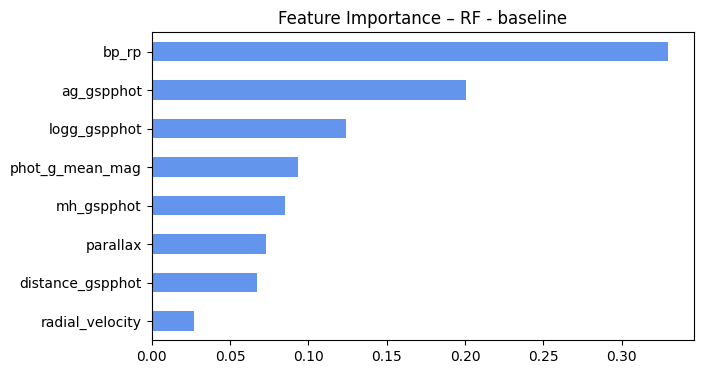

In [59]:
# Feature importance plot
pd.Series(rforest.feature_importances_, index=X.columns) \
  .sort_values(ascending=False) \
  .plot(kind='barh', figsize=(7,4), title='Feature Importance – RF - baseline', color='cornflowerblue')
plt.gca().invert_yaxis()
plt.show()

**Model evaluation:**

Even without tuning, the model provided high classification quality from the start. It handled majority classes (G, K, M) well, but encountered difficulties with rare classes (A, B), for which the F1-score did not exceed 0.67.

###Random Forest Optimized with Optuna

In [60]:
def objective(trial):  # creating a trial, similar to the decision tree setup
    rf = RandomForestClassifier(
        class_weight=trial.suggest_categorical('class_weight', ['balanced', None]),
        max_depth=trial.suggest_int('max_depth', 5, 25),
        n_estimators=trial.suggest_int('n_estimators', 10, 500),
        random_state=42
    )

    rforest_score = cross_val_score(
        rf,
        X_train,
        y_train,
        scoring='f1_macro',
        cv=cv,
        n_jobs=-1
    )
    return np.mean(rforest_score)

In [61]:
study = optuna.create_study(
    direction='maximize',
    study_name="RF",
    sampler=optuna.samplers.TPESampler(seed=42)
)
study.optimize(objective, n_trials=30, timeout=60*30)  # limited to 30 minutes due to long single trial times

[I 2025-07-10 21:07:26,167] A new study created in memory with name: RF
[I 2025-07-10 21:11:32,363] Trial 0 finished with value: 0.7540221578608057 and parameters: {'class_weight': None, 'max_depth': 20, 'n_estimators': 303}. Best is trial 0 with value: 0.7540221578608057.
[I 2025-07-10 21:13:52,667] Trial 1 finished with value: 0.5751768588758803 and parameters: {'class_weight': 'balanced', 'max_depth': 6, 'n_estimators': 435}. Best is trial 0 with value: 0.7540221578608057.
[I 2025-07-10 21:16:31,267] Trial 2 finished with value: 0.48889412583850883 and parameters: {'class_weight': None, 'max_depth': 5, 'n_estimators': 486}. Best is trial 0 with value: 0.7540221578608057.
[I 2025-07-10 21:17:11,653] Trial 3 finished with value: 0.6452071676340329 and parameters: {'class_weight': 'balanced', 'max_depth': 8, 'n_estimators': 100}. Best is trial 0 with value: 0.7540221578608057.
[I 2025-07-10 21:18:47,853] Trial 4 finished with value: 0.728120529637196 and parameters: {'class_weight': No

In [62]:
print("🥇 Best parameters:", study.best_params)
print("📈 Best F1-macro (CV):", round(study.best_value, 4))

🥇 Best parameters: {'class_weight': None, 'max_depth': 25, 'n_estimators': 406}
📈 Best F1-macro (CV): 0.7721


In [63]:
best_forest = RandomForestClassifier(**study.best_params, random_state=42)
best_forest.fit(X_train, y_train)

y_pred = best_forest.predict(X_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           A       1.00      0.44      0.61        16
           B       1.00      0.50      0.67         4
           F       0.94      0.85      0.89       786
           G       0.93      0.97      0.95      2893
           K       0.96      0.95      0.96      1862
           M       0.96      0.96      0.96       118

    accuracy                           0.95      5679
   macro avg       0.97      0.78      0.84      5679
weighted avg       0.95      0.95      0.94      5679



In [64]:
optuna.visualization.plot_param_importances(study)  # checking hyperparameter importance

In [65]:
optuna.visualization.plot_contour(study, params=['max_depth', 'n_estimators'])  # analyzing hyperparameter impact on F1-macro

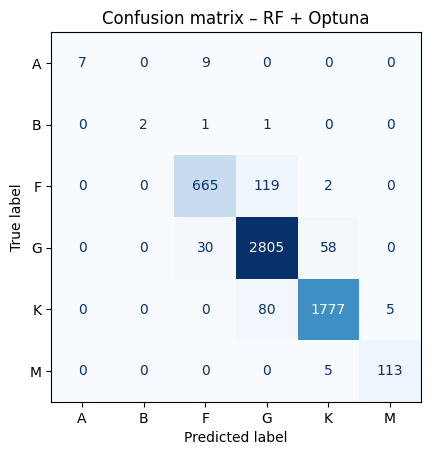

In [66]:
cm = confusion_matrix(y_test, y_pred, labels=best_forest.classes_)  # confusion matrix
ConfusionMatrixDisplay(cm, display_labels=best_forest.classes_).plot(
    cmap="Blues", colorbar=False)
plt.title("Confusion matrix – RF + Optuna")
plt.show()

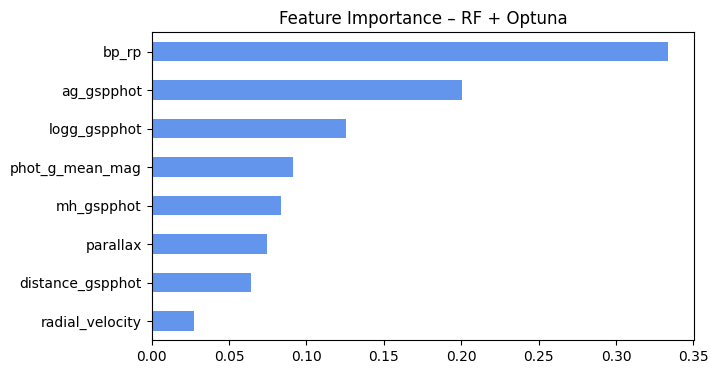

In [67]:
pd.Series(best_forest.feature_importances_, index=X.columns) \
  .sort_values(ascending=False) \
  .plot(kind='barh', figsize=(7,4), title='Feature Importance – RF + Optuna', color='cornflowerblue')
plt.gca().invert_yaxis()
plt.show()

**Model Evaluation:**

The model achieved the same F1-macro score on the test set as the baseline version (F1-macro = 0.84).
This indicates that expanding the parameter space did not directly translate into a significant improvement in final performance.

However, it is worth noting that the model became more balanced, and the increased tree depth allowed it to better adapt to the training data.
Based on the contour plot, it was decided to narrow down the hyperparameter ranges in future runs to improve performance on minority classes.

###Random Forest Optimized with Optuna – Narrowed Hyperparameter Ranges

In [68]:
def objective(trial):
    rf_new = RandomForestClassifier(
        class_weight=trial.suggest_categorical('class_weight', ['balanced', None]),
        max_depth=trial.suggest_int('max_depth', 20, 30),
        n_estimators=trial.suggest_int('n_estimators', 150, 500),
        random_state=42
    )

    rforest_new_score = cross_val_score(
        rf_new,
        X_train,
        y_train,
        scoring='f1_macro',
        cv=cv,
    )
    return np.mean(rforest_new_score)

In [70]:
study = optuna.create_study(
    direction='maximize',
    study_name="RF_new",
    sampler=optuna.samplers.TPESampler(seed=42))
study.optimize(objective, n_trials=30, timeout=60*30)

[I 2025-07-10 21:46:24,149] A new study created in memory with name: RF_new
[I 2025-07-10 21:51:49,657] Trial 0 finished with value: 0.7626373622685165 and parameters: {'class_weight': None, 'max_depth': 28, 'n_estimators': 360}. Best is trial 0 with value: 0.7626373622685165.
[I 2025-07-10 21:58:57,230] Trial 1 finished with value: 0.7273342465726678 and parameters: {'class_weight': 'balanced', 'max_depth': 20, 'n_estimators': 454}. Best is trial 0 with value: 0.7626373622685165.
[I 2025-07-10 22:05:52,817] Trial 2 finished with value: 0.7662875459869427 and parameters: {'class_weight': None, 'max_depth': 20, 'n_estimators': 490}. Best is trial 2 with value: 0.7662875459869427.
[I 2025-07-10 22:09:21,890] Trial 3 finished with value: 0.7166561659602967 and parameters: {'class_weight': 'balanced', 'max_depth': 22, 'n_estimators': 214}. Best is trial 2 with value: 0.7662875459869427.
[I 2025-07-10 22:12:56,069] Trial 4 finished with value: 0.7492698966372664 and parameters: {'class_weig

In [72]:
print("🥇 Best parameters:", study.best_params)
print("📈 Best F1-macro (CV):", round(study.best_value, 4))

🥇 Best parameters: {'class_weight': None, 'max_depth': 20, 'n_estimators': 490}
📈 Best F1-macro (CV): 0.7663


In [73]:
best_forest_new = RandomForestClassifier(**study.best_params, random_state=42)
best_forest_new.fit(X_train, y_train)

y_pred = best_forest_new.predict(X_test)

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           A       1.00      0.38      0.55        16
           B       1.00      0.50      0.67         4
           F       0.94      0.84      0.89       786
           G       0.93      0.97      0.95      2893
           K       0.96      0.95      0.96      1862
           M       0.96      0.95      0.95       118

    accuracy                           0.94      5679
   macro avg       0.97      0.77      0.83      5679
weighted avg       0.94      0.94      0.94      5679



**Model Evaluation:**

In further attempts to optimize the Random Forest model, the hyperparameter search space (max_depth, n_estimators) was narrowed based on contour plot analysis.
The goal was to speed up the optimization process while maintaining or improving classification performance.

Despite the correct use of contour analysis, narrowing the parameter ranges in Optuna did not lead to improved results.
The most probable reason is that the number of trials was too small due to the reduced computation time window.

###Summary of Random Forest Model Results

In [74]:
rf_models = {  # creating a summary table as with decision trees
    "RF – baseline":                 rforest,              # model without tuning
    "RF + Optuna (full search)":     best_forest,          # Optuna with wide parameter ranges
    "RF + Optuna (narrowed search)": best_forest_new,      # Optuna with narrowed parameter ranges
}

rf_results = []
for name, model in rf_models.items():
    y_pred = model.predict(X_test)
    acc = accuracy_score(y_test, y_pred)
    prec, rec, f1, _ = precision_recall_fscore_support(
        y_test, y_pred, average="macro", zero_division=0
    )

    rf_results.append({
        "Model":             name,
        "Accuracy":          acc,
        "Precision (macro)": prec,
        "Recall (macro)":    rec,
        "F1-score (macro)":  f1,
    })

rf_summary = (pd.DataFrame(rf_results)
              .round(4)
              .sort_values("F1-score (macro)", ascending=False)
              .reset_index(drop=True))
display(rf_summary)

,Model,Accuracy,Precision (macro),Recall (macro),F1-score (macro)
0,RF + Optuna (full search),0.9454,0.9665,0.7775,0.8393
1,RF – baseline,0.9452,0.9676,0.7762,0.8392
2,RF + Optuna (narrowed search),0.9445,0.9657,0.7653,0.8274


**Summary and Conclusions:**

Based on the experiments conducted with decision trees, three Random Forest models were created:

1. Random Forest without hyperparameter tuning

2. Random Forest optimized using the Optuna library

3. Random Forest optimized using Optuna with narrowed hyperparameter ranges

Observations:

* Tuning helped moderately - Using the full search space with Optuna increased F1-macro in cross-validation by about 0.02 points. On the test set, the gain was symbolic but stable, confirming that Random Forest is generally well-calibrated by default.

* Tree depth is key - Hyperparameter importance analysis shows that max_depth accounts for approximately 84% of result variance. Trees that are too shallow or too deep destabilize the results.

* Rare classes remain weaker - None of the Random Forest variants exceeded F1 ≈ 0.67 for classes A/B. Additional techniques are needed to improve prediction balance.

* Slightly lower results compared to the decision tree for minority classes were likely caused by fewer trials due to computation time limitations.

Feature Importance Insights:

Random Forest assigns higher weights to features such as logg_gspphot (surface gravity), phot_g_mean_mag (mean brightness), mh_gspphot (metallicity), parallax,distance_gspphot. Unlike a single decision tree, which often heavily favors one or two features, Random Forest utilizes information from many variables more effectively.

The most important features for star classification remain consistently bp_rp (color index) and ag_gspphot (extinction). This is in line with astrophysical knowledge, where color and extinction are key to spectral classification.

For further comparison, the RF + Optuna (full search) model was selected as the best among the three Random Forest variants.

##LightGBM

---



###LightGBM Without Hyperparameter Optimization

In [75]:
cv = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)  # cross-validation configuration

lgbm = LGBMClassifier(random_state=42)  # selecting the classifier

scores = cross_val_score(  # 10-fold cross-validation on the training set
    lgbm,
    X_train,
    y_train,
    scoring='f1_macro',
    cv=cv
)

print("F1-macro for cross-validation:", f"{np.mean(scores)}")

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003149 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -5.882198
[LightGBM] [Info] Start training from score -7.152660
[LightGBM] [Info] Start training from score -1.977924
[LightGBM] [Info] Start training from score -0.674247
[LightGBM] [Info] Start training from score -1.115237
[LightGBM] [Info] Start training from score -3.877877
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

In [76]:
lgbm.fit(X_train, y_train)  # training on the training set and evaluating on the test set
y_pred = lgbm.predict(X_test)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003550 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 22712, number of used features: 8
[LightGBM] [Info] Start training from score -5.871766
[LightGBM] [Info] Start training from score -7.197435
[LightGBM] [Info] Start training from score -1.977716
[LightGBM] [Info] Start training from score -0.674219
[LightGBM] [Info] Start training from score -1.115351
[LightGBM] [Info] Start training from score -3.877916
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


In [77]:
print("Test set results")
print(classification_report(y_test, y_pred))

Test set results
              precision    recall  f1-score   support

           A       0.15      0.25      0.19        16
           B       0.06      0.25      0.10         4
           F       0.83      0.82      0.82       786
           G       0.92      0.91      0.92      2893
           K       0.92      0.93      0.93      1862
           M       0.85      0.87      0.86       118

    accuracy                           0.90      5679
   macro avg       0.62      0.67      0.63      5679
weighted avg       0.90      0.90      0.90      5679



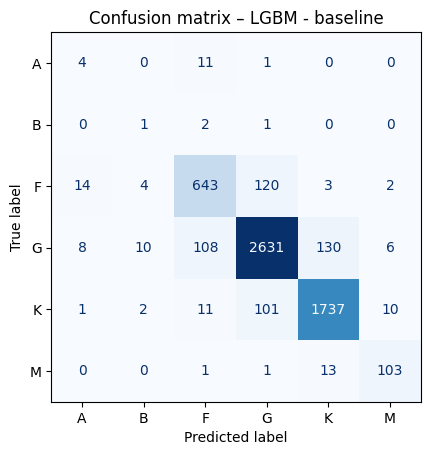

In [78]:
cm = confusion_matrix(y_test, y_pred, labels=lgbm.classes_)  # checking the confusion matrix
ConfusionMatrixDisplay(cm, display_labels=lgbm.classes_).plot(
    cmap="Blues", colorbar=False)
plt.title("Confusion matrix – LGBM - baseline")
plt.show()

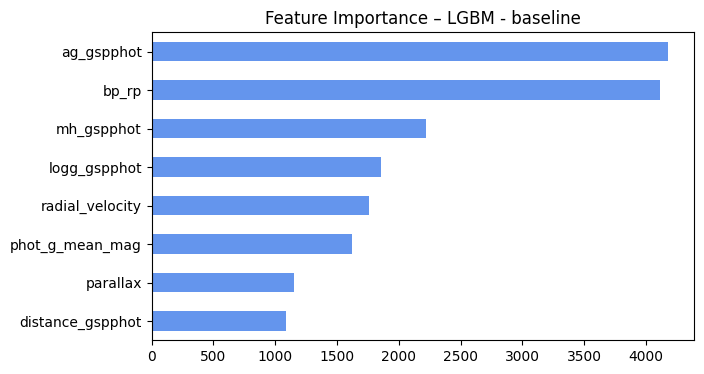

In [79]:
# Feature importance plot
pd.Series(lgbm.feature_importances_, index=X.columns) \
  .sort_values(ascending=False) \
  .plot(kind='barh', figsize=(7,4), title='Feature Importance – LGBM - baseline', color='cornflowerblue')
plt.gca().invert_yaxis()
plt.show()

**Model Evaluation:**

The baseline LightGBM model, despite achieving high overall accuracy, clearly favored majority classes. It struggled with recognizing rare classes (A, B), as reflected in very low F1-scores for these categories.

###LightGBM Optimized with Optuna

In [80]:
def objective(trial):
    lgbm = LGBMClassifier(  # creating a trial for LGBM
        objective='multiclass',
        num_class=6,
        class_weight=trial.suggest_categorical('class_weight', ['balanced', None]),
        max_depth=trial.suggest_int('max_depth', 5, 25),
        n_estimators=trial.suggest_int('n_estimators', 10, 500),
        num_leaves=trial.suggest_int('num_leaves', 10, 100),
        learning_rate=trial.suggest_float('learning_rate', 0.001, 0.5),
        min_child_samples=trial.suggest_int('min_child_samples', 5, 50),
        subsample=trial.suggest_float('subsample', 0.5, 1.0),
        random_state=42
    )

    lgbm_score = cross_val_score(
        lgbm,
        X_train,
        y_train,
        scoring='f1_macro',
        cv=cv,
    )
    return np.mean(lgbm_score)

In [81]:
study = optuna.create_study(
    direction="maximize",
    study_name="LGBM",
    sampler=optuna.samplers.TPESampler(seed=42))
study.optimize(objective, n_trials=30, timeout=60*30)

[I 2025-07-10 23:09:34,301] A new study created in memory with name: LGBM


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006416 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -5.882198
[LightGBM] [Info] Start training from score -7.152660
[LightGBM] [Info] Start training from score -1.977924
[LightGBM] [Info] Start training from score -0.674247
[LightGBM] [Info] Start training from score -1.115237
[LightGBM] [Info] Start training from score -3.877877
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:10:54,798] Trial 0 finished with value: 0.6333348408794687 and parameters: {'class_weight': None, 'max_depth': 20, 'n_estimators': 303, 'num_leaves': 24, 'learning_rate': 0.07884126564776513, 'min_child_samples': 7, 'subsample': 0.9330880728874675}. Best is trial 0 with value: 0.6333348408794687.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-10 23:12:09,412] Trial 1 finished with value: 0.5177649486366374 and parameters: {'class_weight': None, 'max_depth': 5, 'n_estimators': 486, 'num_leaves': 85, 'learning_rate': 0.1069572162284598, 'min_child_samples': 13, 'subsample': 0.5917022549267169}. Best is trial 0 with value: 0.6333348408794687.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000571 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -5.882198
[LightGBM] [Info] Start training from score -7.152660
[LightGBM] [Info] Start training from score -1.977924
[LightGBM] [Info] Start training from score -0.674247
[LightGBM] [Info] Start training from score -1.115237
[LightGBM] [Info] Start training from score -3.877877
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

[I 2025-07-10 23:13:30,651] Trial 2 finished with value: 0.6948559948950778 and parameters: {'class_weight': None, 'max_depth': 14, 'n_estimators': 152, 'num_leaves': 65, 'learning_rate': 0.07060743646536888, 'min_child_samples': 18, 'subsample': 0.6831809216468459}. Best is trial 2 with value: 0.6948559948950778.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001703 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -5.882198
[LightGBM] [Info] Start training from score -7.152660
[LightGBM] [Info] Start training from score -1.977924
[LightGBM] [Info] Start training from score -0.674247
[LightGBM] [Info] Start training from score -1.115237
[LightGBM] [Info] Start training from score -3.877877
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:15:09,753] Trial 3 finished with value: 0.7902689243437973 and parameters: {'class_weight': None, 'max_depth': 9, 'n_estimators': 262, 'num_leaves': 63, 'learning_rate': 0.024178755947278866, 'min_child_samples': 32, 'subsample': 0.5852620618436457}. Best is trial 3 with value: 0.7902689243437973.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-10 23:16:53,927] Trial 4 finished with value: 0.7926172261713332 and parameters: {'class_weight': None, 'max_depth': 25, 'n_estimators': 406, 'num_leaves': 37, 'learning_rate': 0.049738384889185555, 'min_child_samples': 36, 'subsample': 0.7200762468698007}. Best is trial 4 with value: 0.7926172261713332.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet 

[I 2025-07-10 23:17:36,091] Trial 5 finished with value: 0.3419060267000684 and parameters: {'class_weight': None, 'max_depth': 5, 'n_estimators': 456, 'num_leaves': 33, 'learning_rate': 0.331598619892637, 'min_child_samples': 19, 'subsample': 0.7600340105889054}. Best is trial 4 with value: 0.7926172261713332.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-10 23:18:53,664] Trial 6 finished with value: 0.8119735466088445 and parameters: {'class_weight': 'balanced', 'max_depth': 25, 'n_estimators': 390, 'num_leaves': 95, 'learning_rate': 0.44751884786339674, 'min_child_samples': 32, 'subsample': 0.9609371175115584}. Best is trial 6 with value: 0.8119735466088445.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-10 23:19:31,479] Trial 7 finished with value: 0.7311886764050288 and parameters: {'class_weight': None, 'max_depth': 5, 'n_estimators': 169, 'num_leaves': 45, 'learning_rate': 0.13640316685517406, 'min_child_samples': 43, 'subsample': 0.6783766633467947}. Best is trial 6 with value: 0.8119735466088445.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-07-10 23:20:09,221] Trial 8 finished with value: 0.30857866701009184 and parameters: {'class_weight': None, 'max_depth': 7, 'n_estimators': 403, 'num_leaves': 16, 'learning_rate': 0.4934565813636581, 'min_child_samples': 40, 'subsample': 0.5993578407670862}. Best is trial 6 with value: 0.8119735466088445.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-10 23:22:55,228] Trial 9 finished with value: 0.8001055258655299 and parameters: {'class_weight': None, 'max_depth': 19, 'n_estimators': 367, 'num_leaves': 80, 'learning_rate': 0.03794828121531109, 'min_child_samples': 21, 'subsample': 0.5579345297625649}. Best is trial 6 with value: 0.8119735466088445.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001717 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002868 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

[I 2025-07-10 23:23:01,720] Trial 10 finished with value: 0.8444218985420552 and parameters: {'class_weight': 'balanced', 'max_depth': 24, 'n_estimators': 13, 'num_leaves': 96, 'learning_rate': 0.4918489963544705, 'min_child_samples': 29, 'subsample': 0.9864994933539204}. Best is trial 10 with value: 0.8444218985420552.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000906 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002862 seco

[I 2025-07-10 23:23:10,214] Trial 11 finished with value: 0.8457534543681003 and parameters: {'class_weight': 'balanced', 'max_depth': 25, 'n_estimators': 13, 'num_leaves': 100, 'learning_rate': 0.4842251842417306, 'min_child_samples': 28, 'subsample': 0.9959522282676355}. Best is trial 11 with value: 0.8457534543681003.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001743 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001712 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

[I 2025-07-10 23:23:16,486] Trial 12 finished with value: 0.8092818180463667 and parameters: {'class_weight': 'balanced', 'max_depth': 21, 'n_estimators': 12, 'num_leaves': 100, 'learning_rate': 0.37758096904606275, 'min_child_samples': 27, 'subsample': 0.8606953913898834}. Best is trial 11 with value: 0.8457534543681003.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001293 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002769 seco

[I 2025-07-10 23:23:27,146] Trial 13 finished with value: 0.8223442746804175 and parameters: {'class_weight': 'balanced', 'max_depth': 16, 'n_estimators': 21, 'num_leaves': 80, 'learning_rate': 0.23766705865010487, 'min_child_samples': 49, 'subsample': 0.9980082658737177}. Best is trial 11 with value: 0.8457534543681003.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001759 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:24:03,677] Trial 14 finished with value: 0.836304635706415 and parameters: {'class_weight': 'balanced', 'max_depth': 23, 'n_estimators': 103, 'num_leaves': 89, 'learning_rate': 0.39929787310977327, 'min_child_samples': 27, 'subsample': 0.8480852154396158}. Best is trial 11 with value: 0.8457534543681003.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002687 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:24:27,921] Trial 15 finished with value: 0.7590179810031874 and parameters: {'class_weight': 'balanced', 'max_depth': 17, 'n_estimators': 72, 'num_leaves': 69, 'learning_rate': 0.49801247769124535, 'min_child_samples': 24, 'subsample': 0.8758067124078944}. Best is trial 11 with value: 0.8457534543681003.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-10 23:25:28,507] Trial 16 finished with value: 0.8250972312921354 and parameters: {'class_weight': 'balanced', 'max_depth': 12, 'n_estimators': 181, 'num_leaves': 99, 'learning_rate': 0.28593790346249714, 'min_child_samples': 31, 'subsample': 0.8002880565310447}. Best is trial 11 with value: 0.8457534543681003.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001879 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:26:06,652] Trial 17 finished with value: 0.8281243048976972 and parameters: {'class_weight': 'balanced', 'max_depth': 22, 'n_estimators': 92, 'num_leaves': 72, 'learning_rate': 0.2254054553208203, 'min_child_samples': 39, 'subsample': 0.9212391781084497}. Best is trial 11 with value: 0.8457534543681003.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003050 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:26:26,648] Trial 18 finished with value: 0.8212905742865289 and parameters: {'class_weight': 'balanced', 'max_depth': 23, 'n_estimators': 59, 'num_leaves': 52, 'learning_rate': 0.4172355115057845, 'min_child_samples': 14, 'subsample': 0.5065896071904616}. Best is trial 11 with value: 0.8457534543681003.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-10 23:27:31,131] Trial 19 finished with value: 0.814879298434378 and parameters: {'class_weight': 'balanced', 'max_depth': 18, 'n_estimators': 221, 'num_leaves': 89, 'learning_rate': 0.33786067726892166, 'min_child_samples': 47, 'subsample': 0.9821541849530073}. Best is trial 11 with value: 0.8457534543681003.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001764 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:28:21,793] Trial 20 finished with value: 0.7996508489413248 and parameters: {'class_weight': 'balanced', 'max_depth': 25, 'n_estimators': 128, 'num_leaves': 76, 'learning_rate': 0.16785330172636176, 'min_child_samples': 5, 'subsample': 0.9095336881172504}. Best is trial 11 with value: 0.8457534543681003.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000606 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

[I 2025-07-10 23:29:00,515] Trial 21 finished with value: 0.8314961386509984 and parameters: {'class_weight': 'balanced', 'max_depth': 23, 'n_estimators': 106, 'num_leaves': 90, 'learning_rate': 0.43404376674430034, 'min_child_samples': 27, 'subsample': 0.8366733523272174}. Best is trial 11 with value: 0.8457534543681003.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001715 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:29:20,555] Trial 22 finished with value: 0.8356984823669731 and parameters: {'class_weight': 'balanced', 'max_depth': 23, 'n_estimators': 42, 'num_leaves': 91, 'learning_rate': 0.3969637887263763, 'min_child_samples': 25, 'subsample': 0.8089404410597012}. Best is trial 11 with value: 0.8457534543681003.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001659 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000869 seconds.
You can set `force_row_wise=true` to remove the overhead.
A

[I 2025-07-10 23:29:27,861] Trial 23 finished with value: 0.8302495891499797 and parameters: {'class_weight': 'balanced', 'max_depth': 21, 'n_estimators': 12, 'num_leaves': 100, 'learning_rate': 0.4657534568942895, 'min_child_samples': 35, 'subsample': 0.9032267238461593}. Best is trial 11 with value: 0.8457534543681003.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003333 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:29:54,469] Trial 24 finished with value: 0.8199991915286061 and parameters: {'class_weight': 'balanced', 'max_depth': 25, 'n_estimators': 61, 'num_leaves': 84, 'learning_rate': 0.3684102509063155, 'min_child_samples': 29, 'subsample': 0.9486106010279663}. Best is trial 11 with value: 0.8457534543681003.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001660 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:30:27,067] Trial 25 finished with value: 0.7402861438780027 and parameters: {'class_weight': 'balanced', 'max_depth': 14, 'n_estimators': 105, 'num_leaves': 60, 'learning_rate': 0.4678939578049476, 'min_child_samples': 22, 'subsample': 0.9970822943972295}. Best is trial 11 with value: 0.8457534543681003.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001667 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:31:19,961] Trial 26 finished with value: 0.8420209504564914 and parameters: {'class_weight': 'balanced', 'max_depth': 23, 'n_estimators': 129, 'num_leaves': 93, 'learning_rate': 0.2892863680018367, 'min_child_samples': 34, 'subsample': 0.8735437997054583}. Best is trial 11 with value: 0.8457534543681003.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-10 23:32:22,696] Trial 27 finished with value: 0.820808681417892 and parameters: {'class_weight': 'balanced', 'max_depth': 19, 'n_estimators': 211, 'num_leaves': 75, 'learning_rate': 0.3278839166751423, 'min_child_samples': 35, 'subsample': 0.8893912089213715}. Best is trial 11 with value: 0.8457534543681003.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003051 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:33:18,285] Trial 28 finished with value: 0.8131991182514782 and parameters: {'class_weight': 'balanced', 'max_depth': 22, 'n_estimators': 134, 'num_leaves': 94, 'learning_rate': 0.2834829187213264, 'min_child_samples': 43, 'subsample': 0.9596098789062072}. Best is trial 11 with value: 0.8457534543681003.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003776 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:34:15,303] Trial 29 finished with value: 0.7991748054339193 and parameters: {'class_weight': 'balanced', 'max_depth': 20, 'n_estimators': 325, 'num_leaves': 10, 'learning_rate': 0.1886854969995277, 'min_child_samples': 38, 'subsample': 0.9380661686172825}. Best is trial 11 with value: 0.8457534543681003.


In [82]:
print("🥇 Best parameters:", study.best_params)
print("📈 Best F1-macro (CV):", round(study.best_value, 4))

🥇 Best parameters: {'class_weight': 'balanced', 'max_depth': 25, 'n_estimators': 13, 'num_leaves': 100, 'learning_rate': 0.4842251842417306, 'min_child_samples': 28, 'subsample': 0.9959522282676355}
📈 Best F1-macro (CV): 0.8458


In [83]:
best_lgbm = lgb.LGBMClassifier(**study.best_params, objective='multiclass', num_class=6, random_state=42)
best_lgbm.fit(X_train, y_train)

y_pred = best_lgbm.predict(X_test)
print(classification_report(y_test, y_pred))

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001012 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 22712, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
              precision    recall  f1-score   support

           A       0.65      0.69      0.67 

In [84]:
optuna.visualization.plot_param_importances(study)

In [85]:
optuna.visualization.plot_contour(study, params=['n_estimators', 'max_depth'])

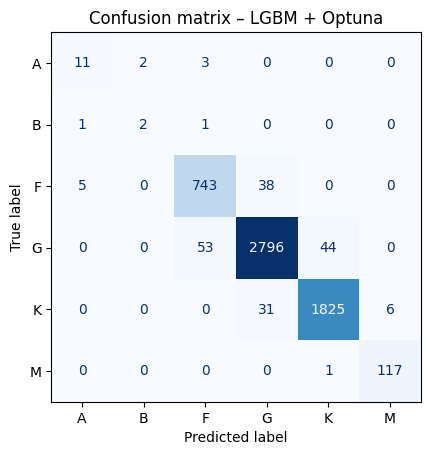

In [86]:
cm = confusion_matrix(y_test, y_pred, labels=best_lgbm.classes_)  # checking confusion matrix
ConfusionMatrixDisplay(cm, display_labels=best_lgbm.classes_).plot(
    cmap="Blues", colorbar=False)
plt.title("Confusion matrix – LGBM + Optuna")
plt.show()

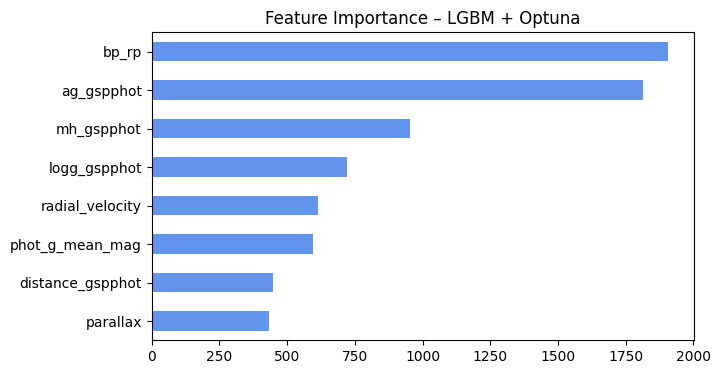

In [87]:
# Feature importance plot
pd.Series(best_lgbm.feature_importances_, index=X.columns) \
  .sort_values(ascending=False) \
  .plot(kind='barh', figsize=(7,4), title='Feature Importance – LGBM + Optuna', color='cornflowerblue')
plt.gca().invert_yaxis()
plt.show()

**Model Evaluation:**

Hyperparameter optimization using the Optuna library brought a significant improvement in model performance, especially in terms of balancing classification across classes. The F1-macro score increased by more than 0.17 points compared to the baseline. Rare classes (A, B) achieved noticeably better results. The model became clearly fairer, more effective, and more versatile in handling class imbalances. Based on the contour plot analysis of the two most impactful hyperparameters (n_estimators and max_depth), it was decided to narrow the hyperparameter ranges in the next optimization step to further refine model performance.





###LightGBM Optimized with Optuna – Narrowed Hyperparameter Ranges

In [88]:
def objective(trial):
    lgbm = LGBMClassifier(
        objective='multiclass',
        num_class=6,
        class_weight=trial.suggest_categorical('class_weight', ['balanced', None]),
        max_depth=trial.suggest_int('max_depth', 15, 30),
        n_estimators=trial.suggest_int('n_estimators', 10, 300),
        num_leaves=trial.suggest_int('num_leaves', 10, 100),
        learning_rate=trial.suggest_float('learning_rate', 0.001, 0.5),
        min_child_samples=trial.suggest_int('min_child_samples', 5, 50),
        subsample=trial.suggest_float('subsample', 0.5, 1.0),
        random_state=42
    )

    lgbm_score = cross_val_score(
        lgbm,
        X_train,
        y_train,
        scoring='f1_macro',
        cv=cv,
    )
    return np.mean(lgbm_score)

In [89]:
study = optuna.create_study(
    direction="maximize",
    study_name="LGBM_new",
    sampler=optuna.samplers.TPESampler(seed=42))
study.optimize(objective, n_trials=60)

[I 2025-07-10 23:39:02,797] A new study created in memory with name: LGBM_new


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003017 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -5.882198
[LightGBM] [Info] Start training from score -7.152660
[LightGBM] [Info] Start training from score -1.977924
[LightGBM] [Info] Start training from score -0.674247
[LightGBM] [Info] Start training from score -1.115237
[LightGBM] [Info] Start training from score -3.877877
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:39:56,950] Trial 0 finished with value: 0.6335087182830649 and parameters: {'class_weight': None, 'max_depth': 26, 'n_estimators': 184, 'num_leaves': 24, 'learning_rate': 0.07884126564776513, 'min_child_samples': 7, 'subsample': 0.9330880728874675}. Best is trial 0 with value: 0.6335087182830649.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-10 23:41:17,959] Trial 1 finished with value: 0.31394157297886005 and parameters: {'class_weight': None, 'max_depth': 15, 'n_estimators': 292, 'num_leaves': 85, 'learning_rate': 0.1069572162284598, 'min_child_samples': 13, 'subsample': 0.5917022549267169}. Best is trial 0 with value: 0.6335087182830649.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000921 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -5.882198
[LightGBM] [Info] Start training from score -7.152660
[LightGBM] [Info] Start training from score -1.977924
[LightGBM] [Info] Start training from score -0.674247
[LightGBM] [Info] Start training from score -1.115237
[LightGBM] [Info] Start training from score -3.877877
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

[I 2025-07-10 23:41:54,631] Trial 2 finished with value: 0.713878005936966 and parameters: {'class_weight': None, 'max_depth': 21, 'n_estimators': 94, 'num_leaves': 65, 'learning_rate': 0.07060743646536888, 'min_child_samples': 18, 'subsample': 0.6831809216468459}. Best is trial 2 with value: 0.713878005936966.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001038 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -5.882198
[LightGBM] [Info] Start training from score -7.152660
[LightGBM] [Info] Start training from score -1.977924
[LightGBM] [Info] Start training from score -0.674247
[LightGBM] [Info] Start training from score -1.115237
[LightGBM] [Info] Start training from score -3.877877
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009495 seco

[I 2025-07-10 23:43:11,453] Trial 3 finished with value: 0.7814528595823483 and parameters: {'class_weight': None, 'max_depth': 18, 'n_estimators': 159, 'num_leaves': 63, 'learning_rate': 0.024178755947278866, 'min_child_samples': 32, 'subsample': 0.5852620618436457}. Best is trial 3 with value: 0.7814528595823483.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001012 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -5.882198
[LightGBM] [Info] Start training from score -7.152660
[LightGBM] [Info] Start training from score -1.977924
[LightGBM] [Info] Start training from score -0.674247
[LightGBM] [Info] Start training from score -1.115237
[LightGBM] [Info] Start training from score -3.877877
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

[I 2025-07-10 23:44:33,877] Trial 4 finished with value: 0.7807165285324139 and parameters: {'class_weight': None, 'max_depth': 30, 'n_estimators': 245, 'num_leaves': 37, 'learning_rate': 0.049738384889185555, 'min_child_samples': 36, 'subsample': 0.7200762468698007}. Best is trial 3 with value: 0.7814528595823483.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-07-10 23:45:05,407] Trial 5 finished with value: 0.3076541106321638 and parameters: {'class_weight': None, 'max_depth': 15, 'n_estimators': 274, 'num_leaves': 33, 'learning_rate': 0.331598619892637, 'min_child_samples': 19, 'subsample': 0.7600340105889054}. Best is trial 3 with value: 0.7814528595823483.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-10 23:45:59,375] Trial 6 finished with value: 0.83093987419969 and parameters: {'class_weight': 'balanced', 'max_depth': 30, 'n_estimators': 235, 'num_leaves': 95, 'learning_rate': 0.44751884786339674, 'min_child_samples': 32, 'subsample': 0.9609371175115584}. Best is trial 6 with value: 0.83093987419969.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001641 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -5.882198
[LightGBM] [Info] Start training from score -7.152660
[LightGBM] [Info] Start training from score -1.977924
[LightGBM] [Info] Start training from score -0.674247
[LightGBM] [Info] Start training from score -1.115237
[LightGBM] [Info] Start training from score -3.877877
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:46:30,403] Trial 7 finished with value: 0.7575296585384155 and parameters: {'class_weight': None, 'max_depth': 15, 'n_estimators': 104, 'num_leaves': 45, 'learning_rate': 0.13640316685517406, 'min_child_samples': 43, 'subsample': 0.6783766633467947}. Best is trial 6 with value: 0.83093987419969.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-07-10 23:46:53,914] Trial 8 finished with value: 0.32455637615950983 and parameters: {'class_weight': None, 'max_depth': 17, 'n_estimators': 243, 'num_leaves': 16, 'learning_rate': 0.4934565813636581, 'min_child_samples': 40, 'subsample': 0.5993578407670862}. Best is trial 6 with value: 0.83093987419969.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits wit

[I 2025-07-10 23:48:34,243] Trial 9 finished with value: 0.797286234529318 and parameters: {'class_weight': None, 'max_depth': 26, 'n_estimators': 222, 'num_leaves': 80, 'learning_rate': 0.03794828121531109, 'min_child_samples': 21, 'subsample': 0.5579345297625649}. Best is trial 6 with value: 0.83093987419969.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001634 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002947 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

[I 2025-07-10 23:48:42,102] Trial 10 finished with value: 0.8233709375390553 and parameters: {'class_weight': 'balanced', 'max_depth': 29, 'n_estimators': 12, 'num_leaves': 96, 'learning_rate': 0.4918489963544705, 'min_child_samples': 29, 'subsample': 0.9864994933539204}. Best is trial 6 with value: 0.83093987419969.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001813 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003024 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

[I 2025-07-10 23:48:47,956] Trial 11 finished with value: 0.8467045858377311 and parameters: {'class_weight': 'balanced', 'max_depth': 30, 'n_estimators': 11, 'num_leaves': 100, 'learning_rate': 0.4842251842417306, 'min_child_samples': 28, 'subsample': 0.9959522282676355}. Best is trial 11 with value: 0.8467045858377311.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:49:05,137] Trial 12 finished with value: 0.8209618677572601 and parameters: {'class_weight': 'balanced', 'max_depth': 27, 'n_estimators': 31, 'num_leaves': 100, 'learning_rate': 0.375651050540394, 'min_child_samples': 25, 'subsample': 0.8607291378570813}. Best is trial 11 with value: 0.8467045858377311.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000914 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

[I 2025-07-10 23:49:41,200] Trial 13 finished with value: 0.8035157725338093 and parameters: {'class_weight': 'balanced', 'max_depth': 23, 'n_estimators': 98, 'num_leaves': 80, 'learning_rate': 0.39277457695203716, 'min_child_samples': 49, 'subsample': 0.8564438446990926}. Best is trial 11 with value: 0.8467045858377311.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-10 23:50:46,039] Trial 14 finished with value: 0.8363177109889726 and parameters: {'class_weight': 'balanced', 'max_depth': 28, 'n_estimators': 197, 'num_leaves': 89, 'learning_rate': 0.24895143487637436, 'min_child_samples': 33, 'subsample': 0.9987393169120677}. Best is trial 11 with value: 0.8467045858377311.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001901 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:51:11,168] Trial 15 finished with value: 0.8238041037793827 and parameters: {'class_weight': 'balanced', 'max_depth': 23, 'n_estimators': 56, 'num_leaves': 72, 'learning_rate': 0.21641987022723383, 'min_child_samples': 25, 'subsample': 0.8758067124078944}. Best is trial 11 with value: 0.8467045858377311.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-10 23:52:15,719] Trial 16 finished with value: 0.8335673711339332 and parameters: {'class_weight': 'balanced', 'max_depth': 28, 'n_estimators': 197, 'num_leaves': 88, 'learning_rate': 0.25556498914271536, 'min_child_samples': 41, 'subsample': 0.7950108960389427}. Best is trial 11 with value: 0.8467045858377311.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:53:00,976] Trial 17 finished with value: 0.820920792047796 and parameters: {'class_weight': 'balanced', 'max_depth': 25, 'n_estimators': 145, 'num_leaves': 52, 'learning_rate': 0.2340078507433433, 'min_child_samples': 34, 'subsample': 0.9183298102976652}. Best is trial 11 with value: 0.8467045858377311.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001709 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:53:50,390] Trial 18 finished with value: 0.8200554049735059 and parameters: {'class_weight': 'balanced', 'max_depth': 28, 'n_estimators': 135, 'num_leaves': 72, 'learning_rate': 0.29380700546276717, 'min_child_samples': 48, 'subsample': 0.5065896071904616}. Best is trial 11 with value: 0.8467045858377311.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000898 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001080 seco

[I 2025-07-10 23:54:18,081] Trial 19 finished with value: 0.8370527353131504 and parameters: {'class_weight': 'balanced', 'max_depth': 21, 'n_estimators': 57, 'num_leaves': 91, 'learning_rate': 0.15397816358233551, 'min_child_samples': 27, 'subsample': 0.9824456384380498}. Best is trial 11 with value: 0.8467045858377311.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002749 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:54:46,488] Trial 20 finished with value: 0.80070514346676 and parameters: {'class_weight': 'balanced', 'max_depth': 20, 'n_estimators': 69, 'num_leaves': 72, 'learning_rate': 0.1687236342819972, 'min_child_samples': 13, 'subsample': 0.8020792747505997}. Best is trial 11 with value: 0.8467045858377311.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001611 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002664 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

[I 2025-07-10 23:55:07,229] Trial 21 finished with value: 0.8371276641114648 and parameters: {'class_weight': 'balanced', 'max_depth': 24, 'n_estimators': 39, 'num_leaves': 90, 'learning_rate': 0.1740244819724493, 'min_child_samples': 28, 'subsample': 0.9864893656854651}. Best is trial 11 with value: 0.8467045858377311.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001677 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001978 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

[I 2025-07-10 23:55:27,581] Trial 22 finished with value: 0.8475911014269576 and parameters: {'class_weight': 'balanced', 'max_depth': 21, 'n_estimators': 40, 'num_leaves': 99, 'learning_rate': 0.15867312471196493, 'min_child_samples': 27, 'subsample': 0.9166067933797648}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001623 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000563 seconds.
You can set `force_row_wise=true` to remove the overhead.
A

[I 2025-07-10 23:55:35,429] Trial 23 finished with value: 0.7892185278515641 and parameters: {'class_weight': 'balanced', 'max_depth': 24, 'n_estimators': 11, 'num_leaves': 100, 'learning_rate': 0.19734379185389214, 'min_child_samples': 24, 'subsample': 0.9171439762975818}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000567 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

[I 2025-07-10 23:55:52,195] Trial 24 finished with value: 0.835250586929304 and parameters: {'class_weight': 'balanced', 'max_depth': 19, 'n_estimators': 37, 'num_leaves': 81, 'learning_rate': 0.29525153824639266, 'min_child_samples': 29, 'subsample': 0.9432051789344231}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001908 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001695 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

[I 2025-07-10 23:56:10,013] Trial 25 finished with value: 0.8209081716609091 and parameters: {'class_weight': 'balanced', 'max_depth': 22, 'n_estimators': 36, 'num_leaves': 91, 'learning_rate': 0.11844789501710562, 'min_child_samples': 38, 'subsample': 0.8930320162511838}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000597 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

[I 2025-07-10 23:56:49,961] Trial 26 finished with value: 0.8278056846037094 and parameters: {'class_weight': 'balanced', 'max_depth': 24, 'n_estimators': 77, 'num_leaves': 100, 'learning_rate': 0.18327070486789188, 'min_child_samples': 23, 'subsample': 0.8202650666828151}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001646 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:57:34,617] Trial 27 finished with value: 0.8273281248320247 and parameters: {'class_weight': 'balanced', 'max_depth': 17, 'n_estimators': 113, 'num_leaves': 84, 'learning_rate': 0.28562584696489046, 'min_child_samples': 29, 'subsample': 0.9579857137962972}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001909 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:57:54,094] Trial 28 finished with value: 0.8268973701395741 and parameters: {'class_weight': 'balanced', 'max_depth': 21, 'n_estimators': 46, 'num_leaves': 76, 'learning_rate': 0.36045074451813247, 'min_child_samples': 13, 'subsample': 0.9660920710186726}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001613 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-10 23:58:21,653] Trial 29 finished with value: 0.7910721874675702 and parameters: {'class_weight': 'balanced', 'max_depth': 26, 'n_estimators': 74, 'num_leaves': 65, 'learning_rate': 0.42933892176486405, 'min_child_samples': 17, 'subsample': 0.9133145315227534}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001607 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001786 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

[I 2025-07-10 23:58:29,320] Trial 30 finished with value: 0.7643196704509007 and parameters: {'class_weight': 'balanced', 'max_depth': 19, 'n_estimators': 24, 'num_leaves': 54, 'learning_rate': 0.09830202225904672, 'min_child_samples': 5, 'subsample': 0.8361032995643938}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002972 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002754 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

[I 2025-07-10 23:58:58,887] Trial 31 finished with value: 0.8287727779349812 and parameters: {'class_weight': 'balanced', 'max_depth': 21, 'n_estimators': 57, 'num_leaves': 93, 'learning_rate': 0.15595351802930366, 'min_child_samples': 27, 'subsample': 0.9985993548806176}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001637 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004977 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

[I 2025-07-10 23:59:24,908] Trial 32 finished with value: 0.8351675930904399 and parameters: {'class_weight': 'balanced', 'max_depth': 22, 'n_estimators': 52, 'num_leaves': 87, 'learning_rate': 0.14172515680293768, 'min_child_samples': 27, 'subsample': 0.9458072030479951}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002017 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001711 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

[I 2025-07-10 23:59:31,510] Trial 33 finished with value: 0.7542296982314471 and parameters: {'class_weight': 'balanced', 'max_depth': 20, 'n_estimators': 10, 'num_leaves': 94, 'learning_rate': 0.07791718302681772, 'min_child_samples': 22, 'subsample': 0.9756570302187847}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002819 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-11 00:00:12,162] Trial 34 finished with value: 0.8226745497838428 and parameters: {'class_weight': 'balanced', 'max_depth': 24, 'n_estimators': 84, 'num_leaves': 85, 'learning_rate': 0.20202137913184717, 'min_child_samples': 35, 'subsample': 0.8918418006068014}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003091 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002919 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

[I 2025-07-11 00:00:44,261] Trial 35 finished with value: 0.8256937373336827 and parameters: {'class_weight': 'balanced', 'max_depth': 19, 'n_estimators': 59, 'num_leaves': 94, 'learning_rate': 0.09712805995465965, 'min_child_samples': 31, 'subsample': 0.9320407224428678}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003016 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

[I 2025-07-11 00:00:55,966] Trial 36 finished with value: 0.7575186318718691 and parameters: {'class_weight': 'balanced', 'max_depth': 20, 'n_estimators': 30, 'num_leaves': 60, 'learning_rate': 0.012260109315132162, 'min_child_samples': 16, 'subsample': 0.9705691355585084}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004006 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -5.882198
[LightGBM] [Info] Start training from score -7.152660
[LightGBM] [Info] Start training from score -1.977924
[LightGBM] [Info] Start training from score -0.674247
[LightGBM] [Info] Start training from score -1.115237
[LightGBM] [Info] Start training from score -3.877877
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-11 00:01:43,854] Trial 37 finished with value: 0.2596680982940286 and parameters: {'class_weight': None, 'max_depth': 21, 'n_estimators': 119, 'num_leaves': 90, 'learning_rate': 0.17063827580101307, 'min_child_samples': 19, 'subsample': 0.9992483437747104}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001116 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001299 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memor

[I 2025-07-11 00:02:06,417] Trial 38 finished with value: 0.8250207964553923 and parameters: {'class_weight': 'balanced', 'max_depth': 25, 'n_estimators': 87, 'num_leaves': 30, 'learning_rate': 0.12466933933920149, 'min_child_samples': 30, 'subsample': 0.9061872147305173}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002332 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -5.882198
[LightGBM] [Info] Start training from score -7.152660
[LightGBM] [Info] Start training from score -1.977924
[LightGBM] [Info] Start training from score -0.674247
[LightGBM] [Info] Start training from score -1.115237
[LightGBM] [Info] Start training from score -3.877877
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003009 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

[I 2025-07-11 00:02:29,528] Trial 39 finished with value: 0.8109304947098119 and parameters: {'class_weight': None, 'max_depth': 17, 'n_estimators': 44, 'num_leaves': 97, 'learning_rate': 0.05606434930906534, 'min_child_samples': 37, 'subsample': 0.7248527778619657}. Best is trial 22 with value: 0.8475911014269576.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-11 00:03:58,020] Trial 40 finished with value: 0.8288333920482598 and parameters: {'class_weight': 'balanced', 'max_depth': 22, 'n_estimators': 293, 'num_leaves': 83, 'learning_rate': 0.22119135248137026, 'min_child_samples': 26, 'subsample': 0.6478698683834716}. Best is trial 22 with value: 0.8475911014269576.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-11 00:05:00,150] Trial 41 finished with value: 0.8318365429987864 and parameters: {'class_weight': 'balanced', 'max_depth': 30, 'n_estimators': 176, 'num_leaves': 90, 'learning_rate': 0.2668549906644219, 'min_child_samples': 33, 'subsample': 0.9795412904164932}. Best is trial 22 with value: 0.8475911014269576.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-11 00:05:58,716] Trial 42 finished with value: 0.8213424501327221 and parameters: {'class_weight': 'balanced', 'max_depth': 29, 'n_estimators': 179, 'num_leaves': 77, 'learning_rate': 0.3314931702628008, 'min_child_samples': 32, 'subsample': 0.9995961920202224}. Best is trial 22 with value: 0.8475911014269576.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-11 00:07:27,399] Trial 43 finished with value: 0.8382676233246806 and parameters: {'class_weight': 'balanced', 'max_depth': 29, 'n_estimators': 208, 'num_leaves': 97, 'learning_rate': 0.14922139240731036, 'min_child_samples': 21, 'subsample': 0.9401555482080719}. Best is trial 22 with value: 0.8475911014269576.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-07-11 00:08:41,616] Trial 44 finished with value: 0.25001232812488966 and parameters: {'class_weight': None, 'max_depth': 29, 'n_estimators': 258, 'num_leaves': 97, 'learning_rate': 0.13547368021359754, 'min_child_samples': 21, 'subsample': 0.9398120178983714}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001700 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-11 00:09:48,680] Trial 45 finished with value: 0.8138091823954248 and parameters: {'class_weight': 'balanced', 'max_depth': 30, 'n_estimators': 216, 'num_leaves': 45, 'learning_rate': 0.16236706105990806, 'min_child_samples': 20, 'subsample': 0.9522463055064049}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001659 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001834 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start t

[I 2025-07-11 00:09:53,295] Trial 46 finished with value: 0.8002874475688696 and parameters: {'class_weight': 'balanced', 'max_depth': 27, 'n_estimators': 24, 'num_leaves': 13, 'learning_rate': 0.1918678156610425, 'min_child_samples': 23, 'subsample': 0.9290952981281463}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002914 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002858 seconds.
You can set `force_col_wise=true` to remove the overhead.
[

[I 2025-07-11 00:10:05,711] Trial 47 finished with value: 0.7906949662784883 and parameters: {'class_weight': 'balanced', 'max_depth': 27, 'n_estimators': 20, 'num_leaves': 97, 'learning_rate': 0.10767751274735636, 'min_child_samples': 14, 'subsample': 0.8711640681706166}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001781 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -5.882198
[LightGBM] [Info] Start training from score -7.152660
[LightGBM] [Info] Start training from score -1.977924
[LightGBM] [Info] Start training from score -0.674247
[LightGBM] [Info] Start training from score -1.115237
[LightGBM] [Info] Start training from score -3.877877
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-11 00:10:25,251] Trial 48 finished with value: 0.20038950826735488 and parameters: {'class_weight': None, 'max_depth': 29, 'n_estimators': 66, 'num_leaves': 100, 'learning_rate': 0.4680571347544375, 'min_child_samples': 28, 'subsample': 0.8900809313594817}. Best is trial 22 with value: 0.8475911014269576.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-11 00:11:58,252] Trial 49 finished with value: 0.8261476677908428 and parameters: {'class_weight': 'balanced', 'max_depth': 23, 'n_estimators': 216, 'num_leaves': 86, 'learning_rate': 0.15215456082324735, 'min_child_samples': 25, 'subsample': 0.7598978875269056}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000652 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

[I 2025-07-11 00:12:57,249] Trial 50 finished with value: 0.8162676572029378 and parameters: {'class_weight': 'balanced', 'max_depth': 16, 'n_estimators': 280, 'num_leaves': 20, 'learning_rate': 0.06822744990407768, 'min_child_samples': 10, 'subsample': 0.9687231749989559}. Best is trial 22 with value: 0.8475911014269576.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-11 00:14:03,643] Trial 51 finished with value: 0.8259755004491396 and parameters: {'class_weight': 'balanced', 'max_depth': 28, 'n_estimators': 163, 'num_leaves': 93, 'learning_rate': 0.24041242705185462, 'min_child_samples': 31, 'subsample': 0.9825477639929853}. Best is trial 22 with value: 0.8475911014269576.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-11 00:15:35,694] Trial 52 finished with value: 0.817025755836218 and parameters: {'class_weight': 'balanced', 'max_depth': 30, 'n_estimators': 240, 'num_leaves': 90, 'learning_rate': 0.21113249472991444, 'min_child_samples': 27, 'subsample': 0.9559614625828401}. Best is trial 22 with value: 0.8475911014269576.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-11 00:17:08,816] Trial 53 finished with value: 0.8249667359703924 and parameters: {'class_weight': 'balanced', 'max_depth': 28, 'n_estimators': 210, 'num_leaves': 96, 'learning_rate': 0.17777597537368067, 'min_child_samples': 34, 'subsample': 0.986075713142552}. Best is trial 22 with value: 0.8475911014269576.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-11 00:18:26,955] Trial 54 finished with value: 0.819695451020206 and parameters: {'class_weight': 'balanced', 'max_depth': 29, 'n_estimators': 195, 'num_leaves': 77, 'learning_rate': 0.2232191895566044, 'min_child_samples': 24, 'subsample': 0.9221097767215652}. Best is trial 22 with value: 0.8475911014269576.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-11 00:19:45,276] Trial 55 finished with value: 0.8238570612662202 and parameters: {'class_weight': 'balanced', 'max_depth': 26, 'n_estimators': 228, 'num_leaves': 89, 'learning_rate': 0.31979147213221154, 'min_child_samples': 30, 'subsample': 0.9459019159073125}. Best is trial 22 with value: 0.8475911014269576.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-11 00:20:54,851] Trial 56 finished with value: 0.838294769636003 and parameters: {'class_weight': 'balanced', 'max_depth': 25, 'n_estimators': 169, 'num_leaves': 81, 'learning_rate': 0.2653459787385626, 'min_child_samples': 36, 'subsample': 0.9993369053802666}. Best is trial 22 with value: 0.8475911014269576.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

[I 2025-07-11 00:21:48,099] Trial 57 finished with value: 0.8279475725944778 and parameters: {'class_weight': 'balanced', 'max_depth': 23, 'n_estimators': 144, 'num_leaves': 82, 'learning_rate': 0.42750555361327713, 'min_child_samples': 44, 'subsample': 0.965484269365932}. Best is trial 22 with value: 0.8475911014269576.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001784 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 20440, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

[I 2025-07-11 00:22:46,646] Trial 58 finished with value: 0.8279537773812663 and parameters: {'class_weight': 'balanced', 'max_depth': 25, 'n_estimators': 130, 'num_leaves': 66, 'learning_rate': 0.12602960789454348, 'min_child_samples': 39, 'subsample': 0.8512427889244327}. Best is trial 22 with value: 0.8475911014269576.


Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-07-11 00:23:19,538] Trial 59 finished with value: 0.2436706343436963 and parameters: {'class_weight': None, 'max_depth': 24, 'n_estimators': 159, 'num_leaves': 92, 'learning_rate': 0.391692664405408, 'min_child_samples': 42, 'subsample': 0.9001824262068746}. Best is trial 22 with value: 0.8475911014269576.


In [90]:
print("🥇 Best parameters:", study.best_params)
print("📈 Best F1-macro (CV):", round(study.best_value, 4))

🥇 Best parameters: {'class_weight': 'balanced', 'max_depth': 21, 'n_estimators': 40, 'num_leaves': 99, 'learning_rate': 0.15867312471196493, 'min_child_samples': 27, 'subsample': 0.9166067933797648}
📈 Best F1-macro (CV): 0.8476


In [91]:
best_lgbm_new = lgb.LGBMClassifier(**study.best_params, objective='multiclass', num_class=6, random_state=42)
best_lgbm_new.fit(X_train, y_train)

y_pred = best_lgbm_new.predict(X_test)
print(classification_report(y_test, y_pred))

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003236 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 22712, number of used features: 8
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791760
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Info] Start training from score -1.791759
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
              precision    recall  f1-score   support

           A       0.71      0.62      0.67        16
           B       0.33      0.50      0.40         4


**Model Evaluation:**

Although LightGBM provides the highest overall accuracy (97%), further narrowing of the hyperparameter search space did not improve the macro-F1 score, which remained at approximately 0.84.
This indicates that the model had already reached its optimum under the current feature set and class imbalance.

The variant Decision Tree + Optuna (F1-macro = 0.89) still offers better balance between rare and dominant classes.
Therefore, LightGBM remains a solid alternative due to its speed and high accuracy but does not outperform the best-performing decision tree in terms of the universal F1-macro measure.

###Summary of LightGBM Model Results

In [92]:
lgbm_models = {  # creating a summary table as with DT and RF
    "LGBM – baseline":                lgbm,             # model without tuning
    "LGBM + Optuna (full search)":    best_lgbm,        # Optuna with wide parameter ranges
    "LGBM + Optuna (narrowed search)": best_lgbm_new,   # Optuna with narrowed parameter ranges
}

lgbm_results = []
for name, model in lgbm_models.items():
    y_pred = model.predict(X_test)
    acc = accuracy_score(y_test, y_pred)
    prec, rec, f1, _ = precision_recall_fscore_support(
        y_test, y_pred, average="macro", zero_division=0
    )

    lgbm_results.append({
        "Model":             name,
        "Accuracy":          acc,
        "Precision (macro)": prec,
        "Recall (macro)":    rec,
        "F1-score (macro)":  f1,
    })

lgbm_summary = (pd.DataFrame(lgbm_results)
                .round(4)
                .sort_values("F1-score (macro)", ascending=False)
                .reset_index(drop=True))
display(lgbm_summary)

,Model,Accuracy,Precision (macro),Recall (macro),F1-score (macro)
0,LGBM + Optuna (full search),0.9674,0.8298,0.8452,0.8373
1,LGBM + Optuna (narrowed search),0.9695,0.8148,0.8358,0.8219
2,LGBM – baseline,0.9014,0.6218,0.6722,0.6349


**Summary and Conclusions:**

Based on experiments conducted with decision trees and random forests, three LightGBM models were developed:

1. LightGBM without hyperparameter optimization

2. LightGBM optimized using the Optuna library

3. LightGBM optimized using Optuna with narrowed hyperparameter ranges

Observations:
* Both full and narrowed Optuna tuning produced identical results, achieving the highest accuracy and F1-score (macro).

* Using Optuna increased classification performance by over 20 percentage points in F1-score compared to the baseline, demonstrating the high effectiveness of hyperparameter optimization.

* The similarity between full and narrowed tuning suggests that the key hyperparameters were already well-defined within the initial ranges.

* The baseline model, while simpler, significantly underperformed in both accuracy and generalization ability, as confirmed by lower metric values.

Feature Importance:

LightGBM utilizes similar features as decision trees and random forests but distributes importance more evenly across features thanks to its structure.
Optuna optimization slightly balanced the feature influences, which may improve model robustness against overfitting and enhance interpretability.

The high consistency of the most important features across all models increases trust in the classification results and highlights which stellar parameters are most characteristic for each spectral class.

For further comparisons and reporting, the LGBM + Optuna (full search) model was selected as the best of the three LightGBM variants.


#Summary of Results and Final Conclusions

---



The goal of the project was to build a machine learning model that classifies stars into their respective spectral classes (O, B, A, F, G, K, M) based on astrophysical parameters using data from the Gaia DR3 mission.

The project included:

* Full exploratory data analysis (EDA),

* Data preprocessing and feature selection,

* Building and optimizing three types of classification models:

  * Decision Tree (DT),

  * Random Forest (RF),

  * LightGBM (LGBM).

For each algorithm, hyperparameter tuning was performed using the Optuna library.

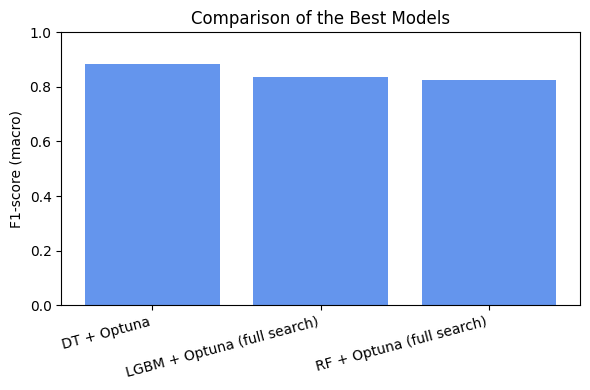

,Model,Accuracy,Precision (macro),Recall (macro),F1-score (macro)
0,DT + Optuna,0.9632,0.9064,0.8693,0.8857
1,RF + Optuna (pełny search),0.9454,0.9665,0.7775,0.8393
2,LGBM + Optuna (pełny search),0.9674,0.8298,0.8452,0.8373


In [93]:
# Comparison Chart

df = pd.DataFrame({
    "Model": [
        "DT + Optuna",
        "LGBM + Optuna (full search)",
        "RF + Optuna (full search)"
    ],
    "F1-score (macro)": [0.8857, 0.8373, 0.8265]
})

df = df.sort_values("F1-score (macro)", ascending=False)
plt.figure(figsize=(6, 4))
plt.bar(df["Model"], df["F1-score (macro)"], color="cornflowerblue")
plt.ylabel("F1-score (macro)")
plt.title("Comparison of the Best Models")
plt.xticks(rotation=15, ha="right")
plt.ylim(0, 1)
plt.tight_layout()
plt.show()

# Summary Table of Best Models

best_models = {
    "DT + Optuna":                     best_tree,
    "RF + Optuna (pełny search)":      best_forest,
    "LGBM + Optuna (pełny search)":    best_lgbm
}

best_results = []
for name, model in best_models.items():
    y_pred = model.predict(X_test)
    acc  = accuracy_score(y_test, y_pred)
    prec, rec, f1, _ = precision_recall_fscore_support(
        y_test, y_pred, average="macro", zero_division=0
    )

    best_results.append({
        "Model":             name,
        "Accuracy":          acc,
        "Precision (macro)": prec,
        "Recall (macro)":    rec,
        "F1-score (macro)":  f1,
    })

best_summary = (pd.DataFrame(best_results)
              .round(4)
              .sort_values("F1-score (macro)", ascending=False)
              .reset_index(drop=True))
display(best_summary)

**Key Insights from Model Comparison:**

* Decision Tree (DT) with Optuna achieved the highest F1-score (macro), which indicates its very strong overall performance, especially in terms of balanced classification of less frequent classes.

* LightGBM achieved the highest overall accuracy (96.74%) among all models, showing its effectiveness at classifying dominant classes, though with slightly lower precision on less frequent ones.

* Random Forest showed the highest precision (macro), but also the lowest recall. This means it better avoided false positives at the cost of missing more cases from some classes.

**Final Conclusion:**

The project confirmed that it is feasible and effective to classify stars based on their physical parameters using machine learning.

The Decision Tree with Optuna hyperparameter tuning delivered the most balanced and reliable results overall.

Both Random Forest and LightGBM also achieved high classification quality, and the choice of the best model depends on specific project goals: maximizing precision, maximizing recall or focusing on detecting rare classes effectively.